# <CENTER>**📊 IV. EXPLORATORY DATA ANALYSIS (EDA) - `PART 2` 📊**<CENTER>
---

## **🏙️ INTRODUCTION**
Gurugram (formerly Gurgaon), located in the National Capital Region (NCR) of India, has emerged as one of the country’s most dynamic real estate markets. Known for its rapid urban development, corporate hubs, and premium residential projects, Gurugram attracts buyers ranging from working professionals and nuclear families to luxury-seeking investors. Over the last decade, the city has witnessed continuous expansion, with new residential sectors, gated societies, and high-rise apartments becoming the backbone of its housing supply.

This notebook presents **Exploratory Data Analysis (EDA)** of flat listings in Gurugram, collected from major online real estate portals such as **Housing.com and 99acres**. The dataset includes detailed information on flat configurations, pricing, area, furnishing status, amenities, sector-level distribution, builder/seller details, and more.

### **Through this EDA, we aim to:**

* Understand the **distribution of flat types** (1 BHK, 2 BHK, 3 BHK, etc.) across the city.
* Compare **pricing trends** across sectors and property sizes.
* Explore the role of **amenities, furnishing, parking, and society features like parking** in influencing property prices.
* Identify **sector-level costliness**, highlighting expensive and affordable clusters.
* Derive insights for **buyers, investors, and developers** about prevailing market trends.

The Gurugram housing market is **often described** as **mid-segment driven**, dominated by **2 BHK and 3 BHK flats**, with limited but significant presence of luxury and ultra-luxury properties. At the same time, affordability and sector-level differences play a crucial role in shaping buyer preferences. This analysis will uncover such patterns and provide a data-backed perspective on Gurugram’s residential real estate landscape.


---
---

<br>

### **IMPORTING DATA :**

In [43]:
## Importing necessary tools for Data Manipulation and Visualisation:
import pandas as pd                      ## Pandas for data manipulation
pd.options.display.max_columns = None

import numpy as np                       ## Numpy for mathematical computation
import matplotlib.pyplot as plt          ## pyplot module of Matplotlib for visualization

import seaborn as sns                    ## Seaborn for visualization
import plotly.graph_objects as go        ## Plotly for dynamic and interactive visualization
import plotly.express as px
from plotly.subplots import make_subplots

from wordcloud import WordCloud          ## For making Word Cloud

import All_graphs_module as myplots      ## Importing module in which all my poltting logic and code is saved
                                          
from PIL import Image
import warnings
warnings.filterwarnings("ignore")        ## Hides all warnings

In [44]:
df = pd.read_csv('Housing_Listings_all_records_(numbers)_FINAL_Cleaned_FE.csv', index_col = 'Unnamed: 0')
df.head(2)

,Flat,Sector,Address,Seller_Builder,EMI,EMI_in_rupees,Built_Up_Area,Built_up_area_in_sqft,Avg_Price,Avg_price_rupee_per_sqft,Age_of_property,Age_of_property_in_years,Possession_status,Floor,Floor_number,Building_height,Facing,Furnishing,Society,Brokerage,Brokerage_in_rupees,Price,Price_in_rupees,Bedrooms,Bathrooms,Parking,Covered_parking,Open_parking,Balcony,Advertised,Amenities,Nearby_landmarks,Prop_description,Link,Sector_Amenity_Score
0,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹36.01 K,36010,593 sq.ft,593,₹11.47 K/sq.ft,11470.0,1 Years Old,1,Ready to move,12 of 14,12,14,East facing,Semi Furnished,Pyramid Elite,"68,000",68000,68.0 L,6800000,2,2,1 Open Parking,0,1,1,More than a month ago,"['Lift', 'Power Backup', 'Garden', 'Sports', '...","[['School', ""St. Xavier's High School""], ['Hos...",Looking for a 2 BHK Flat for sale in Gurgaon? ...,https://housing.com/in/buy/resale/page/1761033...,2.0
1,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹33.36 K,33360,690 sq.ft,690,₹9.13 K/sq.ft,9130.0,1 Years Old,1,Ready to move,4 of 15,4,15,-,Unfurnished,Pyramid Elite,"63,000",63000,63.0 L,6300000,2,2,No Parking,0,0,1,17 days ago,NaN,"[['School', ""St. Xavier's High School""], ['Hos...",Best 2 BHK Flat for modern-day lifestyle is no...,https://housing.com/in/buy/resale/page/1681859...,2.0


<br><br>

<br>

# **`IV. 🪑 Furnishing, Facing, and Floor Features`**
---

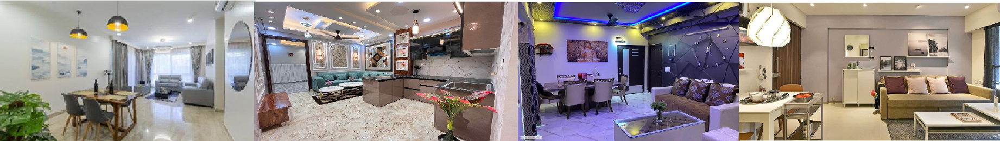

In real estate, **`FURNISHING`** refers to the **level of interiors** and **fittings provided** within a property **at the time of sale or rent**. 
- Properties are typically categorized as **UNFURNISHED** (basic structure without furniture or appliances),
- **SEMI-FURNISHED** (includes essential fittings like wardrobes, kitchen cabinets, fans, and lights), and
- **FULLY FURNISHED** (equipped with furniture, appliances, and ready-to-move-in setups).


**Furnishing directly impacts** a property’s **market value, rental demand, and buyer preference** — with ***fully furnished units appealing to tenants and short-term buyers***, while unfurnished or semi-furnished units attract buyers who prefer customization. 


In markets like Gurugram, **semi-furnished properties dominate**, balancing affordability with convenience, whereas **luxury segments often demand fully furnished homes** as a lifestyle offering.

---
#### **`Let's talk about the "Furnisihing Status" of Gurugram Flats:`**
- Start with inspecting 'Furnishing' feature in data:
    + What all categories are present?
    + Frequency of each category (including percentage)
    + Is there any skew in favor of one category?

In [427]:
## Lets analyze Furnishing Status of Flats in Gurugram for Sale:
data = df['Furnishing'].value_counts().sort_index()[1:]
data = pd.DataFrame(data.values, index = data.index, columns = ['Total Flats'])
data['Percentage Contribution'] = round((data['Total Flats'] / data.iloc[:,0].sum()) * 100, 
                                        2).apply(lambda x: str(x) + '%')
data

,Total Flats,Percentage Contribution
Furnishing,,
Fully Furnished,478,6.7%
Semi Furnished,5386,75.46%
Unfurnished,1274,17.85%


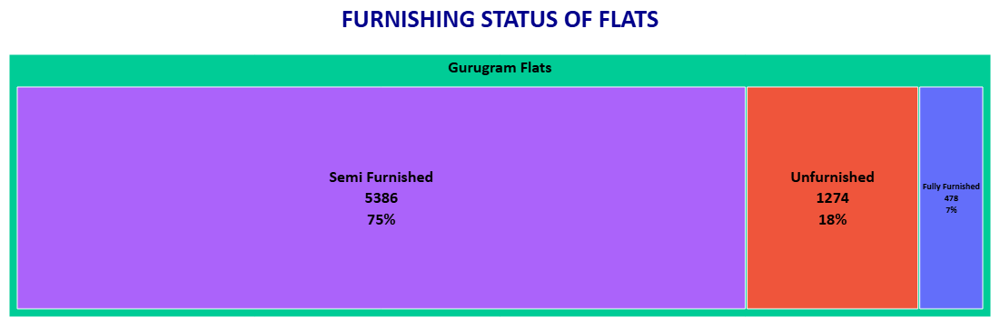

In [389]:
def treemap_furnishing_status():
    ## Creating a TreeMap:
    data = df[df['Furnishing'] != '-']
    
    fig = px.treemap(data, path=[px.Constant('Gurugram Flats'),'Furnishing'], 
                     values = pd.Series(np.ones(data.shape[0])).astype('int8'),
                     color = 'Furnishing' , color_continuous_scale='Blues')
    
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=60, b=10),
                      title=dict(text="<b>FURNISHING STATUS OF FLATS</b>",
                                 font=dict(size=28, color="darkblue", family='Calibri'),
                                 x = 0.5,  pad=dict(t=50, b=0, l=20, r=20)), paper_bgcolor='white')
    
    fig.update_traces(textinfo="label+value+percent entry",
                      hovertemplate='<b>%{label}</b><br>Count: %{value}<br><extra></extra>',
                      textfont=dict(size=18, color="black", family="Calibri black"),
                      textposition="middle center", tiling=dict(pad=2) )
    fig.show()

treemap_furnishing_status()

<br>

#### 📊 **Key Takeaways on Furnishing Status of Gurugram Flats**
1. 🏠 **Semi-Furnished dominates** → **~ 75% of flats**, striking the **best balance between affordability & convenience.**
2. 🛋️ **Fully Furnished is niche** → **Only ~ 7%**, targeted at **luxury buyers seeking ready-to-move-in homes**.
3. 🧱 **Unfurnished has scope** → **~ 18%**, appealing **to buyers wanting customization** or **investors planning upgrades**.


✅ **Overall Insight:** Gurugram’s **flat market is largely semi-furnished driven** (skewed), aligning with the demand for cost-effective yet practical homes. **Fully furnished properties** remain a **luxury niche**, while unfurnished flats appeal to buyers seeking personalization or long-term investment flexibility.

<br>

---
# **`A.` Distribution of Furnishing Status across 5 Major Flat Types.**

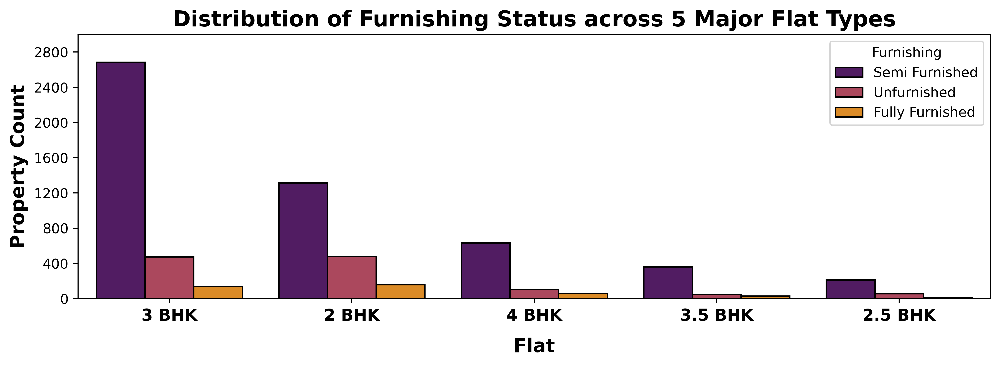

In [119]:
def Furnishing_Status_VS_5_Major_Flats():
    ## Preparing data:
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    data = df[(df['Furnishing'] != '-') & (df['Flat'].isin(five_maj_ft))]
    
    ##----------------------------------------------------------------------------
    ## Creating Plot:
    fig = plt.figure(figsize=(12,3.5), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    sns.countplot(data=data, x='Flat', hue = 'Furnishing', palette="inferno", ax = ax,
                  order=data['Flat'].value_counts().index, edgecolor = 'black')
    
    ax.set_title("Distribution of Furnishing Status across 5 Major Flat Types", fontsize = 16, 
                 fontweight = 'bold')
    ax.set_xlabel("Flat", fontsize = 14, fontweight = 'bold', labelpad=10)
    ax.set_ylabel("Property Count", fontsize = 14, fontweight = 'bold')
    
    ax.set_xticks(list(range(5)))
    ax.set_xticklabels([i[:-5] for i in data['Flat'].value_counts().index], 
                       fontsize = 12, fontweight = 'bold', rotation=0)
    
    ax.set_ylim(0, 3000)
    ax.set_yticks(list(range(0,3000, 400)))
    
    plt.show()

Furnishing_Status_VS_5_Major_Flats()

In [46]:
## Data for further reference:
five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
data = df[(df['Furnishing'] != '-') & (df['Flat'].isin(five_maj_ft))]
data = data.groupby(by = ['Flat', 'Furnishing']).apply(lambda x: x.shape[0]).unstack()

def func_in(x):
    tot = x.sum()
    temp = " (" + round((x / tot) * 100 , 2).astype(str) + "% )"
    x = x.astype(str)
    new = pd.concat([x + temp , pd.Series([tot], index = ['Total'])])
    return new

data = data.apply(func_in, axis = 1)
data

,Fully Furnished,Semi Furnished,Unfurnished,Total
Flat,,,,
2 BHK Flat,159 (8.16% ),1313 (67.4% ),476 (24.44% ),1948
2.5 BHK Flat,8 (2.91% ),212 (77.09% ),55 (20.0% ),275
3 BHK Flat,141 (4.28% ),2684 (81.38% ),473 (14.34% ),3298
3.5 BHK Flat,28 (6.41% ),360 (82.38% ),49 (11.21% ),437
4 BHK Flat,59 (7.4% ),633 (79.42% ),105 (13.17% ),797


### **`🔍 OBSERVATIONS :`**
* **3 BHK Flats:** Highest overall count; **majority are semi-furnished**, with **smaller shares of unfurnished and fully furnished units**.
* **2 BHK Flats:** Second largest in volume; distribution shows a similar pattern with **semi-furnished dominating**, but a **relatively higher proportion of unfurnished flats compared to 3 BHK**.
* **4 BHK Flats:** Moderate volume; **still largely semi-furnished** but with a **slightly greater share of fully furnished flats than smaller flat types**.
* **3.5 BHK & 2.5 BHK Flats:** **Lowest volumes across categories**; again, semi-furnished dominates, with **minimal presence of fully furnished flats**.


### **`💡 Interpretation`**
* **Semi-furnished** status is the **market norm across all BHK types**, highlighting ***buyer demand for essential fittings without full customization***.
* **2 BHK flats** have a higher share of **unfurnished units**, indicating **affordability-driven buyers** who prefer to customize interiors.
* **Larger flats (4 BHK and above)** show a **slightly higher share of fully furnished units**, reflecting positioning **towards luxury buyers** seeking ready-to-move convenience.
* **Niche categories (2.5 & 3.5 BHK)** have **limited supply across furnishing types**, indicating **smaller demand pools** or specialized projects.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * **2 & 3 BHK buyers** will **mostly find semi-furnished options**; those **seeking affordable options with customizable uints** should **target 2 BHK unfurnished**.
  * **Luxury buyers** looking for **fully furnished properties** will **find relatively more options in 4 BHK** flats.
* **Developers:**
  * Continue focusing on **semi-furnished inventory** as the **mainstream demand driver**.
  * **For premium projects**, offering **fully furnished packages** can **capture high-end buyers**.
* **Investors:**
  * Semi-furnished 2 & 3 BHK flats provide better **liquidity and rental potential**.
  * Fully furnished 4 BHKs can be positioned for **expat rentals or corporate leasing markets**.

---

### **`✅ CONCLUSION :`**
The data shows that **semi-furnished flats dominate across all BHK categories**, especially in 2 & 3 BHK, confirming them as the **most market-aligned offering**. **Unfurnished flats** are **more prevalent in smaller units (2 BHK)**, appealing to budget-conscious buyers, while **fully furnished flats** are relatively **more common in larger units (4 BHK)**, catering to luxury-seeking segments. This **reflects** a **clear furnishing preference segmentation in Gurugram’s housing market** — affordability vs convenience vs luxury.

<br><br>

---
# **`B.` How does Furnishing Status affects Property Pricing and Property Price Density (in ₹/Sq.ft)?**
- Does higher furnishing commands better cost?
- Are unfurnished units cheaper and affordable options?
- How much premium does the furnished units command?

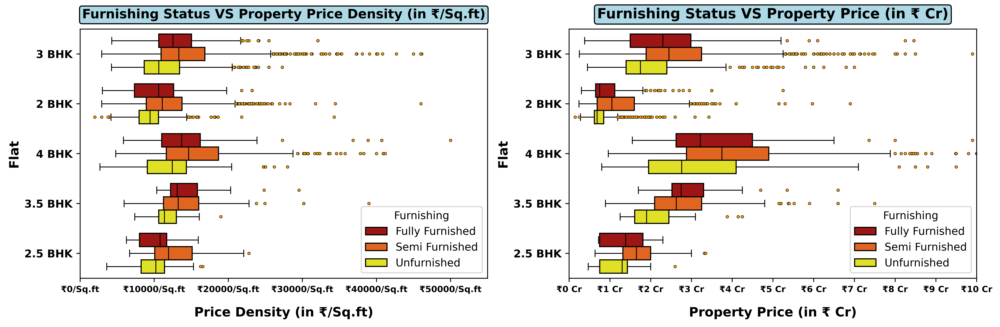

In [81]:
def Furnishing_Status_affects_Property_Pricing_and_Property_Price_Density():
    ## Preparing data:
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    data = df[(df['Furnishing'] != '-') & (df['Flat'].isin(five_maj_ft))]
    
    ##----------------------------------------------------------------------------
    ## Creating Plot:
    fig = plt.figure(figsize=(15,4.2), dpi=600)
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    sns.boxplot(data=data, y='Flat', x = 'Avg_price_rupee_per_sqft' , hue = 'Furnishing', ax=ax1,
                     palette="hot", order=data['Flat'].value_counts().index, 
                     hue_order=data['Furnishing'].value_counts().sort_index().index, linecolor='black',
                     linewidth=0.8, flierprops=dict(marker='o', markerfacecolor='orange', markersize=2.5, 
                                     markeredgecolor='black', markeredgewidth = 0.4), 
                     boxprops=dict(edgecolor='black', linewidth=1))
    
    ax1.set_title("Furnishing Status VS Property Price Density (in ₹/Sq.ft)", 
                 fontsize = 12, fontweight='bold', bbox = bbox, pad = 10)
    ax1.set_xlabel("Price Density (in ₹/Sq.ft)", fontsize = 12, fontweight='bold', labelpad = 12)
    ax1.set_ylabel("Flat", fontsize = 12, fontweight='bold')
    
    ax1.set_xlim(0, 55000)
    ax1.set_xticks(list(range(0,55000, 10000)))
    ax1.set_xticklabels(['₹'+str(i)+'/Sq.ft' for i in range(0,55000, 10000)], fontsize=8, fontweight='bold')
    ax1.set_yticks(list(range(5)))
    ax1.set_yticklabels([i[:-5] for i in data['Flat'].value_counts().index], fontsize=10, fontweight='bold')
    
    ## ------------------------------------------------------------------------------------------------------
    sns.boxplot(data=data, y='Flat', x = 'Price_in_rupees' , hue = 'Furnishing', ax = ax2,
                palette="hot", order=data['Flat'].value_counts().index, 
                hue_order=data['Furnishing'].value_counts().sort_index().index, linecolor='black',
                linewidth=0.8, flierprops=dict(marker='o', markerfacecolor='orange', markersize=2.5, 
                                     markeredgecolor='black', markeredgewidth = 0.4), 
                boxprops=dict(edgecolor='black', linewidth=1))
    
    ax2.set_title("Furnishing Status VS Property Price (in ₹ Cr)", 
                 fontsize = 13, fontweight='bold', bbox = bbox, pad = 10)
    ax2.set_xlabel("Property Price (in ₹ Cr)", fontsize = 12, fontweight='bold', labelpad = 12)
    ax2.set_ylabel("Flat", fontsize = 12, fontweight='bold')
    
    ax2.set_xlim(0, 10e7)
    ax2.set_xticks(list(range(0,100000001, 10000000)))
    ax2.set_xticklabels(['₹'+str(int(i/10000000))+' Cr' for i in range(0,100000001, 10000000)], 
                       fontsize = 8, fontweight='bold')
    ax2.set_yticks(list(range(5)))
    ax2.set_yticklabels([i[:-5] for i in data['Flat'].value_counts().index], 
                       fontsize = 10, fontweight='bold')
    
    plt.show()

Furnishing_Status_affects_Property_Pricing_and_Property_Price_Density()

### **`🔍 OBSERVATIONS :`**
* **Across all flat types** (2 BHK to 4 BHK), **fully furnished & semi-furnished units** show **higher median property price and price density (₹/Sq.ft)** compared to Unfurnished units.
* **Semi-furnished flats** dominate in numbers and cluster in the mid-range for both property price and price density.
* **Unfurnished flats** consistently appear at the lower end of the spectrum, with **lower medians** and **smaller ranges**.
* **Variability** (outliers) is **highest in 3 BHK and 4 BHK flats**, especially for semi-furnished and fully furnished categories, **showing wide market heterogeneity**.
* **2.5 BHK and 3.5 BHK** segments **show tighter distributions**, with **less variability** across furnishing types.<br><br>
**`NOTE :`** We **cannot infer** that **Median Cost of Semi-Furnished properties is larger than Fully Furnished Properties** because **categories are highly imbalanced** and **only 7% of total are Fully Furnished Properties**.


### **`💡 Interpretation`**
* Furnishing status has a **direct impact on property valuation** — **fully furnished & semi-furnished units** command a **visible premium** both in per Sq.ft pricing and overall cost.
* **Semi-furnished** is the **baseline market standard** — appealing to mainstream buyers with affordability and partial convenience.
* **Unfurnished units** act as **entry-level options**, priced more competitively, often attractive for budget buyers or investors planning customization.
* Higher **furnishing impact** is more **pronounced in larger flats (3 BHK & 4 BHK)**, indicating that luxury and lifestyle-driven buyers value ready-to-move furnished setups.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Budget-conscious buyers will find **unfurnished units** as affordable entry points.
  * Families and professionals prefer **semi-furnished**, balancing affordability and convenience.
  * Luxury buyers lean towards **fully furnished**, paying for move-in readiness and premium living.
* **Developers:**
  * Offering **semi-furnished units as the standard** is market-aligned.
  * For premium/luxury projects, **fully furnished packages** can justify higher selling prices and differentiate offerings.
* **Investors:**
  * **Unfurnished flats** are **cheaper upfront** but **may need investment** in interiors **for rental/resale**.
  * **Fully furnished units** may yield higher rental income, especially from corporates and expats, offsetting their premium purchase cost.

---

### **`✅ CONCLUSION :`**
**Furnishing clearly influences** both **property price and per Sq.ft cost** in Gurugram. Fully furnished units commands the **high premiums**, semi-furnished dominate as the **mainstream choice**, while unfurnished remain the **affordable and customizable option**. The **premium effect is stronger in larger flats**, underscoring the role of furnishing as a **luxury differentiator** in the real estate market.

---

#### **`❓ Answers to Specific Questions :`**
#### **Does higher furnishing command better cost?**
- ✅ **YES**, fully furnished & semi-furnished units consistently command higher property prices and price densities.

#### **Are unfurnished units cheaper and affordable options?**
- ✅ **YES**, unfurnished flats are the **most affordable**, catering to **entry-level buyers** and customization seekers.

#### **How much premium does the furnished units command?**
- 📈 On average, **fully furnished & semi-furnished units command ~10–20% higher price density (₹/Sq.ft) and overall cost** compared to unfurnished, with the **premium being more pronounced in larger BHK flats**.

<br><br>

---
---
#### **`Let's talk about the "Facing" of Properties :`**

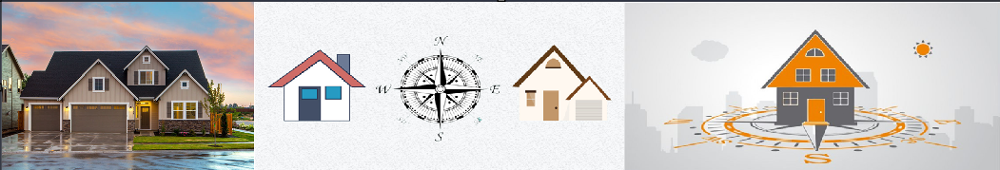

- Start with inspecting 'Facing' feature from data - *It tells the direction in which Flat faces*:
    + What all categories are present?
    + Frequency of each category (including percentage)
    + Is there any skew in favor of one category?

In [114]:
## Lets analyze 'Facing' of Flats:
data = df['Facing'].value_counts().sort_index()[1:]
data = pd.DataFrame(data.values, index = data.index, columns = ['Total Flats'])
data['Percentage'] = round((data['Total Flats'] / data.iloc[:,0].sum()) * 100, 
                                        2).apply(lambda x: str(x) + '%')
data = data.sort_values(by = 'Total Flats', ascending = False).T
data

Facing,North-East facing,East facing,North facing,North-West facing,West facing,South-East facing,South-West facing,South facing
Total Flats,1785,1416,859,378,318,189,149,130
Percentage,34.17%,27.11%,16.44%,7.24%,6.09%,3.62%,2.85%,2.49%


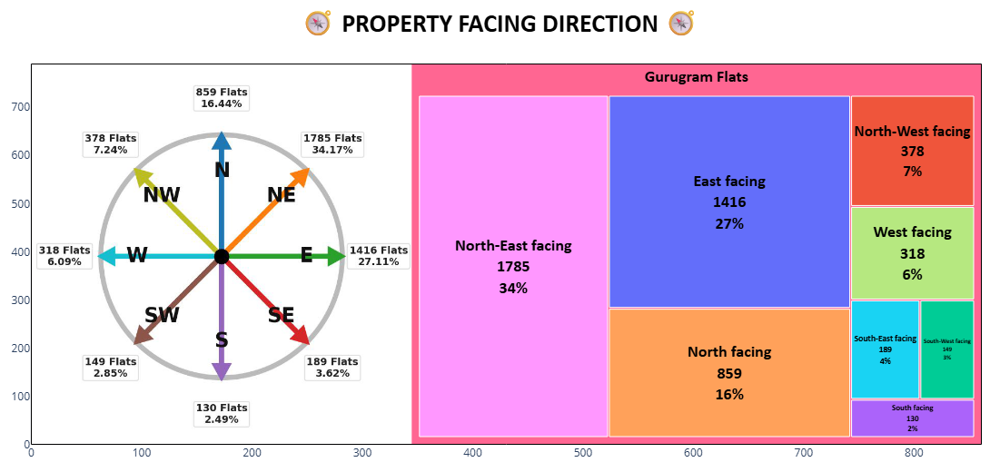

In [9]:
def Flat_Facing_Compass_and_treemap():
    ## Preparing Data
    data = df[df['Facing'] != '-']
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot:
    ## 1) Building TreeMap for "Facing" Feature:
    tmap = px.treemap(data, path=[px.Constant('Gurugram Flats'), 'Facing'], color='Facing',
                      values=pd.Series(np.ones(data.shape[0])).astype('int8'), color_continuous_scale='Blues')
    tmap.update_traces(textinfo="label+value+percent entry", 
                       hovertemplate='<b>%{label}</b><br>Count: %{value}<br><extra></extra>', 
                       textfont=dict(size=18, color="black", family="Calibri black"), 
                       textposition="middle center", tiling=dict(pad=2) )
    
    ## -----------------------------
    ## 2) Two-column canvas: left domain (treemap), right xy (image)
    fig = make_subplots(rows=1, cols=2, specs=[[{"type": "xy"}, {"type": "domain"}]], 
                        column_widths=[0.40, 0.60], horizontal_spacing=0)
    
    # Add treemap traces to the LEFT only
    for tr in tmap.data:
        fig.add_trace(tr, row=1, col=2)
    
    # ------------------------------------------------------------------------------------------------
    ## 3) Right panel: place image tied to x2/y2 axes
    image_path = "Facing_Directions.jpg"                 ## file path or URL
    
    # Determine true size to preserve aspect
    img = Image.open(image_path)
    w, h = img.size
    img_src = img
    
    ## Draw the image exactly inside the right subplot
    fig.add_layout_image( dict(source=img_src, xref="x1", yref="y1", 
                               x=-70, y=-80,              # bottom-left 
                               xanchor="left",           # anchor image at bottom-left
                               yanchor="bottom",
                               sizex=w+150, sizey=h+150, sizing="stretch", layer="above"))
    
    ## Configure right axes so the image fills the panel and axes are invisible
    fig.update_xaxes(row=1, col=1, range=[0, w], showgrid=False, showticklabels=False, zeroline=False)
    fig.update_yaxes(row=1, col=1, range=[0, h], showgrid=False, showticklabels=False, zeroline=False,
                     scaleanchor="x1", scaleratio=1 )
    
    ## Optional thin border for the image panel
    fig.add_shape( type="rect", xref="x2", yref="y2",
                  x0=0, y0=h, x1=w, y1=0, line=dict(color="black", width=1)   )
    
    ## -----------------------------
    ## 4) Global layout: single title, no panning
    fig.update_layout(template="plotly_white", height=520, margin=dict(l=20, r=20, t=70, b=30),
        title=dict(text="<b>🧭 PROPERTY FACING DIRECTION 🧭</b>", x=0.5, 
                   font=dict(size=28, color="black", family="Calibri")),
        coloraxis_showscale=False,  # hide treemap colorbar if present
        dragmode=False)
    
    # Also remove or limit modebar tools (optional)
    fig.show(config=dict(displaylogo=False,
        modeBarButtonsToRemove=["pan2d", "zoom2d","select2d","lasso2d","zoomIn2d","zoomOut2d","autoScale2d",
                                "resetScale2d","toImage"]))

Flat_Facing_Compass_and_treemap()

### **`🔍 Quick Observations :`**
* The **majority of flats** are **North-East facing (34%)** and **East facing (27%)**, together making up over **60% of the total supply**.
* **North facing flats** form the **third-largest group** at **16%**, showing a **strong buyer/developer preference for North-oriented designs**.
* **West, North-West, South-East, South-West, and South-facing flats** are **much fewer in number**, **collectively** contributing **less than 25%**.
* **South-facing flats are the least common (2.5%)**, reflecting **low demand** or **market avoidance due to cultural/architectural preferences**.


✅ The **`data shows a strong skew`** **toward North-East and East-facing flats** (together ~61%), ***aligning with Vastu compliance*** and higher market demand.

<br><br>

---
# **`C.` Aggregated Property Price across different Flat Facing Types ?**
- Is there any significant impact of facing type on flat price?
- Does certain flat facing command premium pricing?

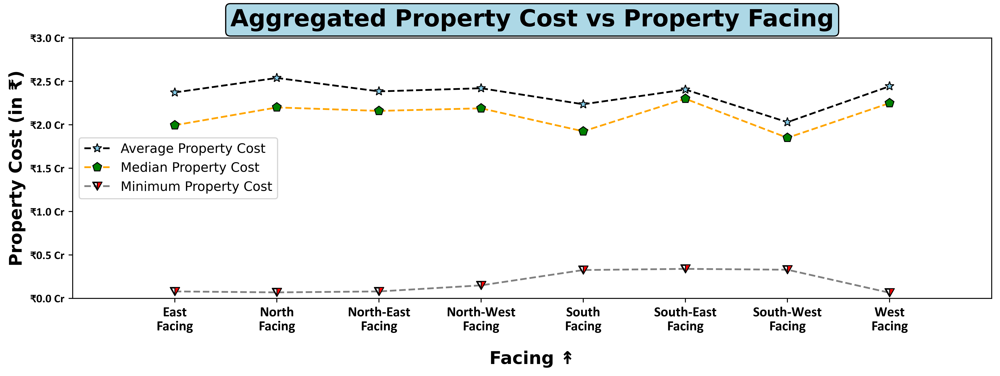

In [45]:
def Facing_VS_Agg_Property_Price():
    ## Preparing data for Plot:
    data = df[(df["Facing"] != '-')]
    
    ## Grouping data based on Age of the Property (in Yrs) and finding mean and median "Property Price" 
    ## for each of the group:
    def func_bed(data):
        pro_pri = data['Price_in_rupees']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data = data.groupby(by = 'Facing').apply(func_bed).astype({('Price', 'tot_prop_listed'):'int32'})
    data = data.sort_index().reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (14,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.plot(data['Facing'], data[('Price', 'mean')], linewidth=1.5, color='black', linestyle='--',
            label = 'Average Property Cost', marker = '*', markersize  = 8,  markerfacecolor='skyblue',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Facing'], data[('Price', 'median')], color='orange', linestyle='--',
            linewidth=1.5, label = 'Median Property Cost', marker = 'p', markersize  = 8, 
            markerfacecolor='green',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Facing'], data[('Price', 'min')], linewidth=1.5, color='grey', linestyle='--',
            label = 'Minimum Property Cost', marker = '$⧩$', markersize  = 8,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Aggregated Property Cost vs Property Facing', 
                 fontsize=20, fontweight='bold', bbox = bbox, pad = 10)
    ax.set_ylabel('Property Cost (in ₹)', fontsize=15, fontweight='bold')
    ax.set_xlabel('Facing ↟', fontsize=15, fontweight='bold', labelpad=15)
    
    ax.set_xlim(-1, 8)
    ax.set_xticks(list(range(0, 8)))
    ax.set_xticklabels([i[:-7] + '\n' + i[-6:].capitalize() 
                        for i in data['Facing']], rotation = 0, fontsize = 12, fontweight = 'bold',
                      family='calibri')
    
    ax.set_ylim(0,3e7)
    ax.set_yticks(list(range(0, 30000001, 5000000)))
    ax.set_yticklabels([f"₹{round(i/10000000, 2)} Cr" for i in range(0, 30000001, 5000000)], 
                       fontsize = 10, fontweight = 'bold', family='calibri')
    
    ax.legend(fontsize=11, loc = 'center left')
    
    plt.show()

Facing_VS_Agg_Property_Price()

### **`🔍 OBSERVATIONS :`**
* **Median and average property costs** range mostly between **₹2.0 Cr – ₹2.5 Cr** across **all facings**.
* **East, North, and North-East facings** cluster **near** the **higher end of the spectrum**, with median costs closer to ₹2.2 Cr.
* **South and South-West facings** show relatively **lower median costs (~ ₹1.8 – 1.9 Cr)**.
* **West-facing flats** rebound slightly, **with higher median (~ ₹2.2 Cr)**, though distribution is narrower.
* **Minimum costs** are **generally low for most facings**, with South/South-East/South-West showing slightly higher floor prices. NOTE: There total property counts are very low, so data is not sufficient to make any clear inference.


### **`💡 Interpretation`**
* **Flat facing direction DOES HAVE an influence** on **property pricing**, though the variation is **very moderate rather than extreme**.
* **East, North, and North-East** facings are **relatively more valued**, consistent with cultural/Vastu preferences.
* **South and South-West facing flats** are **less preferred**, commanding **lower median values**.
* Despite these variations, the **overall spread is not very wide (~ ₹0.5 Cr difference in medians)**, suggesting that location, BHK type, and furnishing **weigh more heavily than facing alone**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * **Buyers prioritizing cultural or Vastu norms** (East/North-East/North) **may pay** a **slight premium** for favorable facings.
  * Budget-conscious buyers can explore South/South-West-facing options for **better value**.
* **Developers:**
  * Projects can **highlight East/North-East facings** as a **value-added feature** to **attract culturally inclined buyers**.
  * Pricing South/South-West-facing flats more competitively can help balance inventory absorption.
* **Investors:**
  * Investing in **East/North-East-facing units** may provide **better resale appeal**.
  * South-facing units may yield **better rental ROI** if priced lower, given affordability-driven tenants.

---

### **`✅ CONCLUSION :`**
Flat facing direction shows a **noticeable but not dominant effect** on property prices in Gurugram. **East, North, and North-East-facing flats command a modest premium**, while **South and South-West facings** are **relatively discounted**. However, the **price gaps remain moderate**, reinforcing that **facing is a secondary factor** compared to flat size, location, and furnishing in overall property valuation.

---

#### **`❓ Answers to Specific Questions :`**
#### **Is there any significant impact of facing type on flat price?**
✅ Facing type **does impact price**, but the **effect is very moderate** (**premium of ~ ₹0.3 – 0.4 Cr for favorable facings**).

#### **Does certain flat facing command premium pricing?**
✅ **YES** — **East, North, and North-East-facing flats** command a **premium**, while **South and South-West-facing** are relatively **cheaper**.

<br><br>

---
# **`D.` Which Property Facing direction aligns with Indian Vaastu traditions?** 
- How many of such properties do we have?
- Is their any Price Premium for Vaastu complaint properties?

---
# <U>**`VAASTU SHASTRA`**<U>
- **`Vaastu Shastra 🙏`** (or *Vastu Vidya*) is a **traditional Indian architectural system that links directions, layout, and energy flow**. It’s similar in spirit to Feng Shui in Chinese culture.
- ➡️ In Vaastu, the **direction your property faces** is considered important because each direction is associated with a ruling element and deity.

| Direction | Significance | Associations | Notes |
|-----------|--------------|--------------|-------|
| 🌅 East Facing | Very auspicious | Lord Surya (Sun God) → health, vitality, prosperity | Often recommended for main entrances |
| 🌞 North Facing | Good for wealth & prosperity | Lord Kuber (deity of wealth) | Popular for business-oriented families, professionals |
| 🌄 North-East (Ishanya) Facing | Most auspicious | Spirituality, harmony, peace, growth | Ideal for pooja rooms, meditation spaces, water elements |
| 🔥 South Facing | Less favorable (sometimes avoided) | Yama (Lord of Death) → challenges | Can be balanced with modern Vaastu planning |
| 🌬 North-West Facing | Neutral to moderately good | Vayu (Air God) → movement, social connections | Good for jobs/business involving travel, networking |
| 🌋 South-East Facing | Mixed results | Agni (Fire God) → energy, passion | Good for kitchens; entrances may bring conflicts |
| 🪨 South-West Facing | Least favorable | Stability but obstacles | May cause health & relationship issues if not corrected |
| 🌇 West Facing | Not most preferred, but not inauspicious | Lord Varuna (Water God) | Brings stability, slow & steady prosperity |

---

#### **`📌 SUMMARY`** (general Vaastu preference for Property Entrance):
* **Most preferred →** North-East, East, North
* **Less preferred →** West, North-West, South-East, South, South-West



#### **`⚠️ IMPORTANT NOTE :`** 
Vaastu is a **traditional belief system**, ***not a scientific rule***. Many modern architects and urban planners treat it as a **cultural preference** — it may influence property value in India because buyers often care about it.

---


<br><br>

## **`D.1.`How many Properties are Vaastu Compliant (i.e., Entrance facing in preferred direction)?**

In [44]:
pref_directions = ["North-East facing", "East facing", "North facing"]
data = df[df['Facing'] != '-']

data = data['Facing'].apply(lambda x: 'Vaastu Compliant' if x in pref_directions 
                     else "Non-Compliant").value_counts()

data = pd.DataFrame(data.values, index = data.index , columns = ['Property Count'])
data['Percentage'] = round((data['Property Count'] / data['Property Count'].sum()) * 100, 
                           2).astype('str') + " %"
data

,Property Count,Percentage
Facing,,
Vaastu Compliant,4060,77.72 %
Non-Compliant,1164,22.28 %


### **`🔍 Quick Observations :`**
* A **large majority** of flats (**77.72% or 4,060 units**) are **Vaastu compliant**.
* Only **22.28% (1,164 units)** fall under the **non-compliant** category.
* This **indicates** a **clear market preference** toward Vaastu-compliant properties.


### **`💡 Interpretation`**
* **Builders and developers** are **aligning** with **cultural and buyer expectations**, ensuring most flats follow Vaastu guidelines.
* **Non-compliant flats** form a smaller share, **possibly in older projects** or **cases where design constraints override Vaastu orientation**.

---

### **`✅ CONCLUSION :`**
The Gurugram housing market is **heavily skewed toward Vaastu-compliant flats (~78%)**, reflecting **strong cultural influence in property design** and **buyer demand**. **Non-compliant flats** are a **minority (22%)**, likely catering to buyers less concerned with Vaastu or those prioritizing price over orientation.

---

<br><br>

## **`D.2.` Is their any "Price Premium" for Vaastu Complaint Properties?**

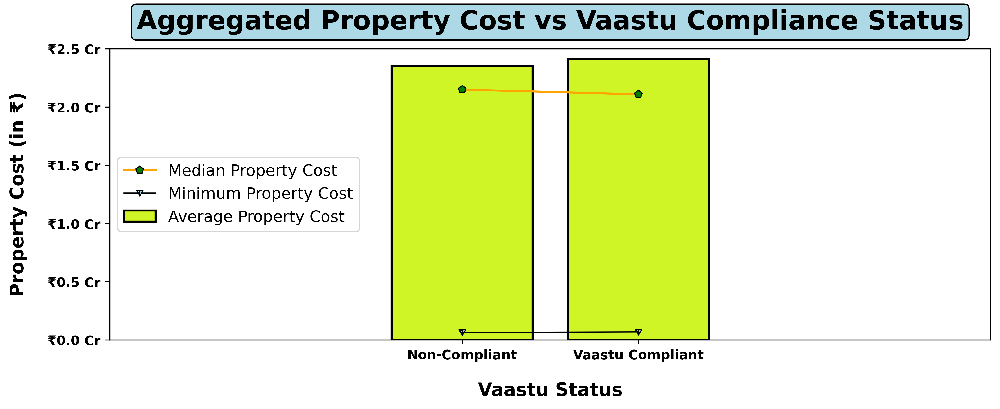

In [315]:
def Vaastu_status_VS_Agg_Property_Price():
    ## Preparing data for Plot:
    pref_directions = ["North-East facing", "East facing", "North facing"]
    data = df[df["Facing"] != '-']
    data['Vaastu'] = data['Facing'].apply(lambda x: 'Vaastu Compliant' if x in pref_directions 
                                          else "Non-Compliant")
    
    ## Grouping data based on "Vaastu Compliance" and finding mean and median "Property Price" for each group:
    def func_bed(data):
        pro_pri = data['Price_in_rupees']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
                         index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                            ('Price', 'max'), ('Price', 'mean'), 
                                                            ('Price', 'median')]))
    
    data = data.groupby(by = 'Vaastu'
                       ).apply(func_bed).astype({('Price', 'tot_prop_listed'):'int32'}).reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (12,4), dpi = 400)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.bar(height = data[('Price', 'mean')], x = data['Vaastu'].astype(str), 
           color='#CFF527', linewidth=1.5, edgecolor='black', label = 'Average Property Cost')
    
    ax.plot(data['Vaastu'].astype(str), data[('Price', 'median')], color='orange', 
            linewidth=1.5, label = 'Median Property Cost', marker = 'p', markersize  = 6, 
            markerfacecolor='green',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Vaastu'].astype(str), data[('Price', 'min')], linewidth=1, color = 'black',
            label = 'Minimum Property Cost', marker = '$⧩$', markersize  = 5,  markerfacecolor='skyblue',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Aggregated Property Cost vs Vaastu Compliance Status', 
                 fontsize=20, fontweight='bold', bbox = bbox, pad = 15)
    ax.set_ylabel('Property Cost (in ₹)', fontsize=14, fontweight='bold', labelpad=15)
    ax.set_xlabel('Vaastu Status', fontsize=14, fontweight='bold', labelpad=15)
    
    ax.set_xlim(-2, 3)
    ax.set_xticks(list(range(0, 2)))
    ax.set_xticklabels(data['Vaastu'].astype(str), rotation = 0, fontsize = 10, fontweight = 'bold')
    
    ax.set_ylim(0, 2.5e7)
    ax.set_yticks(list(range(0, 25000001, 5000000)))
    ax.set_yticklabels([f"₹{round(i/10000000, 2)} Cr" for i in range(0, 25000001, 5000000)], 
                       fontsize = 10, fontweight = 'bold')
    
    ax.legend(fontsize=12, loc = 'center left')
    
    plt.show()

Vaastu_status_VS_Agg_Property_Price()

### **`🔍 OBSERVATIONS :`**
* **Average property cost** is **slightly higher** for **Vaastu compliant flats (~ ₹2.4–2.5 Cr)** compared to **non-compliant (~₹2.3–2.4 Cr)**.
* **Median property costs** are **almost similar** (~ ₹2.1–2.2 Cr) for both categories.
* **Minimum property cost** values **overlap**, showing **no significant difference at the entry-level**.
* **Overall cost distribution does not show** a ***large gap*** between compliant and non-compliant flats.


### **`💡 Interpretation`**
* While **Vaastu compliant flats form the majority of supply (~ 78%)**, their **pricing premium is modest**.
* The **small gap suggests** that **buyers do pay slightly more for Vaastu compliance**, but it is **not the sole driver of property pricing**.
* **Other factors** like BHK size, location, amenities, and furnishing **likely weigh more** heavily **in determining flat cost**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Vaastu compliance may bring **psychological and cultural comfort**, but price differences are not drastic — **non-compliant flats can be affordable alternatives**.
* **Developers:**
  * **Ensuring Vaastu compliance** can help with **marketability and faster absorption**, but **pricing advantage is limited**.
* **Investors:**
  * **Vaastu-compliant flats** may have a **slightly stronger resale appeal**, though appreciation will still depend on broader market factors.

---

### **`✅ CONCLUSION :`**
**Vaastu compliance** in Gurugram flats **commands** only a **slight premium in average property cost**, with median and minimum costs nearly identical to non-compliant flats. This **indicates that** while **Vaastu is culturally significant and influences buyer sentiment**, it **does not dramatically alter property pricing**. It acts more as a **marketability factor** than a strong price determinant.

---

#### **`❓ Answers to Specific Questions`**
#### **Is their any "Price Premium" for Vaastu Complaint Properties?**
✅ **YES**. **Vaastu compliant flats** show a **slight premium (~ ₹0.1–0.2 Cr on average)**, but the **gap** is **not large enough to be considered a strong pricing driver**.

<br><br>

---
---
#### **`Let's talk about the "Floor" features of Properties :`**
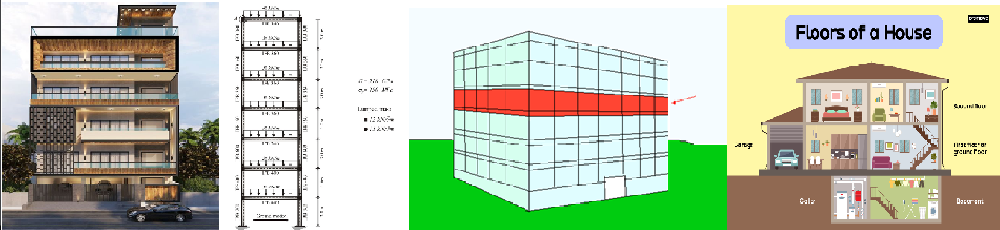
- Start with inspecting 'Floor' features like "Floor Number" & "Building Height":
    + Distribution of Floor Number and Building Height.
    + Most Frequent Floors for Sale (including percentage)?
    + Is there any skew in distribution?

+ Note: If **'Building Height'** is **10** than it means there is **"Ground Floor + 10 Floors above it"**.

In [26]:
## Preparinf data for Analysis:
df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
data = df[df['Floor'] != '-'].astype({'Floor_number': 'int32', 'Building_height': 'int32'})

stats = data[['Floor_number', 'Building_height']].describe().T
stats = round(stats, 2).astype({'count':'int32', 'min': 'int32', 'max': 'int32'})
stats.index = ['Floor Number', 'Building Height']
stats.rename(columns={'count':'Tot. Properties', 'mean': 'Mean', 'min': 'Minimum', 'max': 'Maximum'})

,Tot. Properties,Mean,std,Minimum,25%,50%,75%,Maximum
Floor Number,6796,8.41,6.18,0,4.0,7.0,11.0,55
Building Height,6796,17.85,9.09,1,13.0,15.0,22.0,66


### **`🔍 Quick Observations :`**
* **`Floor Number:`**
  * Mean = **8.4**, Median = **7**, with **most flats** located **between 4th and 11th floors** (IQR).
  * Range spans from **0 (ground-level units)** to as high as **55th floor**, showing **presence of both low-rise and high-rise developments**.
  * **High Standard Deviation of 6.18** indicates **significant variation in floor levels** across properties.<br><br>
* **`Building Height:`**
  * Mean = **17.8 floors**, Median = **15 floors**, suggesting **mid-to-high rise structures dominate** the market.
  * **Most buildings** range **between 13 and 22 floors** (IQR).
  * Heights extend up to **66 floors**, indicating **presence of skyscraper-level projects** in Gurugram.
  * **Higher STD (9.09)** reflects **wide diversity in project sizes** (from low-rise to very tall towers).

---

### **💡 Interpretation**
* Gurugram has a **diverse real estate landscape**, ranging from **low-rise societies to very tall high-rise towers**.
* The **median floor number (7) vs median building height (15)** suggests **most flats are in** the **mid-level range**, aligning with buyer preference for **balance between view and accessibility**.
* Presence of **buildings up to 66 floors** indicates a **strong luxury/high-density housing segment**.

---

### **`✅ Conclusion :`**
The **data highlights** Gurugram’s **mixed development pattern**, with a dominance of **mid-rise living (7th–15th floor)** but **also a significant presence** of **ultra-high-rise projects**. This spread reflects the city’s positioning as both a **mainstream residential hub** and a **luxury high-rise market**.

<br><br>

---
# **`E.` Distribution of Floor Number and Building Height.**

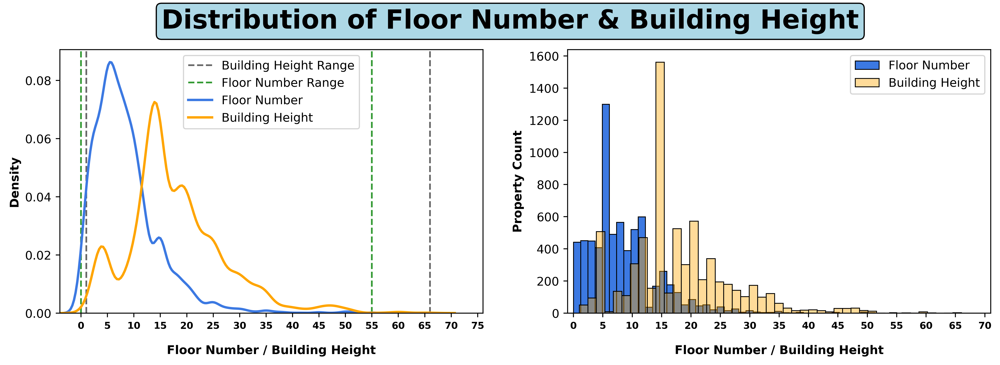

In [215]:
def Distribution_of_Floor_Number_and_Building_Height():
    ## Preparinf data for Analysis:
    df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
    data = df[df['Floor'] != '-'].astype({'Floor_number': 'int32', 'Building_height': 'int32'})
    
    ## --------------------------------------------------------------------------------------------
    ## Creating Plots:
    fig = plt.figure(figsize = (14,4), dpi = 500)
    ax1 = fig.add_subplot(1,2,1)
    ax2 = fig.add_subplot(1,2,2)
    
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    fig.suptitle("Distribution of Floor Number & Building Height" , fontweight = 'bold', fontsize = 22, 
                 color = 'black', ha='center', x=0.5, y=1.0,bbox = bbox)
    
    ## Plotting KDE plots in ax1:
    ax1.axvline(data['Building_height'].max(), linestyle = '--', color='black', linewidth = 1.4, alpha=0.6,
               label = 'Building Height Range')
    ax1.axvline(data['Building_height'].min(), linestyle = '--', color='black', linewidth = 1.4, alpha=0.6)
    
    ax1.axvline(data['Floor_number'].max(), linestyle = '--', color='green', linewidth = 1.4, alpha=0.8,
                label = 'Floor Number Range')
    ax1.axvline(data['Floor_number'].min(), linestyle = '--', color='green', linewidth = 1.4, alpha=0.8)
    
    sns.kdeplot(data = data, x = 'Floor_number',ax = ax1, label =  "Floor Number", color = '#3C79E2',
               linewidth = 2)
    sns.kdeplot(data = data, x = 'Building_height',ax = ax1, label =  "Building Height", color = 'orange',
               linewidth = 2)
    
    ax1.set_xlabel("Floor Number / Building Height", fontsize = 10, fontweight = 'bold', labelpad = 12)
    ax1.set_ylabel("Density", fontsize = 10, fontweight = 'bold')
    
    ax1.set_xlim(-4, 76)
    ax1.set_xticks(list(range(0, 76, 5)))
    ax1.set_xticklabels(list(range(0, 76, 5)), fontsize = 8, fontweight = 'bold')
    
    ax1.legend()
    
    ## Plotting Hist Plot on ax2:
    sns.histplot(data=data, x='Floor_number',ax=ax2, label="Floor Number", color='#3C79E2', alpha=1,
                 bins = 45)
    sns.histplot(data=data, x='Building_height',ax=ax2, label="Building Height", color='orange', alpha=0.4,
                 bins = 45)
    
    ax2.set_xlabel("Floor Number / Building Height", fontsize = 10, fontweight = 'bold', labelpad = 12)
    ax2.set_ylabel("Property Count", fontsize = 10, fontweight = 'bold')
    
    ax2.set_xlim(-1, 71)
    ax2.set_xticks(list(range(0, 71, 5)))
    ax2.set_xticklabels(list(range(0, 71, 5)), fontsize = 8, fontweight = 'bold')
    
    ax2.legend()
    plt.show()

Distribution_of_Floor_Number_and_Building_Height()

### **`🔍 OBSERVATIONS :`**
* **`Floor Numbers (blue curve/bars):`**
  * **Most flats** are concentrated in the **lower-to-mid floors (0–15)**, with a **peak around** the **5th–10th floors**.
  * The **density drops sharply after 20th floor**, showing **fewer flats in higher-rise levels**.
  * **Some flats** exist **at extreme high floors (>40)**, but they are **rare**.<br><br>
* **`Building Heights (orange curve/bars):`**
  * **Majority of buildings** range between **10–25 floors**, with a **peak near 15 floors**.
  * Distribution shows a **long right tail**, with a **few towers extending beyond 50 floors**, up to **66 floors**.
  * **Building height distribution** is **more spread out** compared to floor numbers.


### **`💡 Interpretation`**
* Gurugram’s housing market is **dominated by mid-rise towers (10–20 floors)**, which **accommodate most flats** between **4th and 12th floors**.
* **Buyers seem to prefer *Mid-Level Flats*** (*neither too low nor too high*), which balance accessibility with views/ventilation.
* The presence of **super high-rise buildings (40+ floors)** indicates a luxury-driven, **niche market segment**.
* **Floor preference distribution** being **skewed toward Lower-Mid Levels** suggests practical buyer considerations like **lift dependency, safety, and cost efficiency**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * **Mid-level floors (5–12th floor)** are the **most common**, offering balanced supply and pricing.
  * **High-rise flats (at 20+ floors)** are **limited** and may carry a **luxury premium** due to exclusivity.
* **Developers:**
  * **Demand is strongest** in **mid-rise constructions**, hence projects between **15–25 floors** are **market-aligned**.
  * **High-rise towers (>40 floors)** should be positioned as **luxury offerings** with premium amenities.
* **Investors:**
  * Properties on **popular mid-level floors** offer **stronger resale and rental demand**.
  * **High-rise flats** may yield niche demand, suitable for **long-term appreciation** in premium segments.

---

### **`✅ CONCLUSION :`**
The distribution **confirms Gurugram’s real estate landscape** is **Mid-rise dominated**, with **most offerings concentrated** on **4th–12th floor** in **10–25 floor towers**. While **super high-rise developments exist**, they form a **small, luxury-driven niche**. This indicates that **floor preference is practical and mid-level centric**, while ultra-high-rise supply is targeted at exclusive, high-income groups.

<br><br>

---
# **`F.` Most Frequent Floors for Sale.**

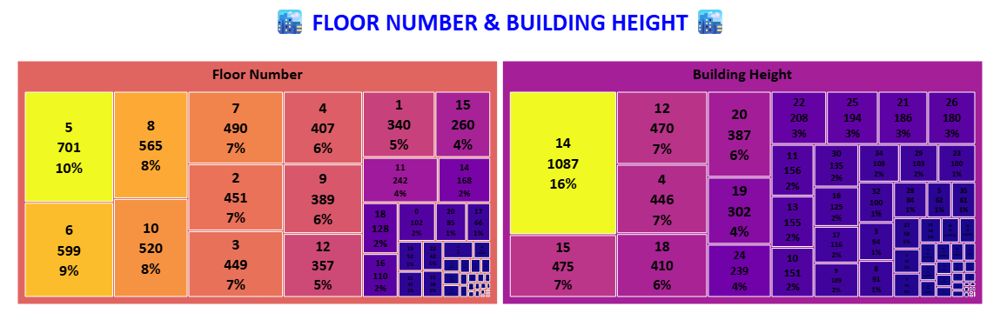

In [92]:
def frequency_distribution_FN_and_BH_2_treemaps():
    ## Preparinf data for Analysis:
    df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
    data = df[df['Floor'] != '-'].astype({'Floor_number': 'int32', 'Building_height': 'int32'})
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating side by side TreeMaps:
    ## 1) Building 1st TreeMap for "Floor Number":
    data_f = pd.DataFrame(data['Floor_number'].value_counts()).reset_index()
    
    tmap_FN = px.treemap(data_f, path=[px.Constant('Floor Number'), 'Floor_number'], 
                         values='count', color='count', color_continuous_scale='solar_r')
    
    tmap_FN.update_traces(textinfo="label+value+percent entry", 
                          hovertemplate='<b>Floor Number: %{label}</b><br>Total listings: %{value}<br><extra></extra>', 
                          textfont=dict(size=18, color="black", family="Calibri black"), 
                          textposition="middle center", tiling=dict(pad=2))
    
    ## 2) Building 2nd TreeMap for "Building Height":
    data_bh = pd.DataFrame(data['Building_height'].value_counts()).reset_index()
    
    tmap_BH = px.treemap(data_bh, path=[px.Constant('Building Height'), 'Building_height'], 
                         values='count', color='count', 
                         color_continuous_scale='solar_r')
    
    tmap_BH.update_traces(textinfo="label+value+percent entry", 
                          hovertemplate='<b>Building Height: %{label}</b><br>Total listings: %{value}<br><extra></extra>', 
                          textfont=dict(size=18, color="black", family="Calibri black"), 
                          textposition="middle center", tiling=dict(pad=2))
    
    ## -----------------------------
    ## 3) Two-column canvas: left domain (treemap), right again domain (treemap)
    fig = make_subplots(rows=1, cols=2, specs=[[{"type": "domain"}, {"type": "domain"}]], 
                        column_widths=[0.50, 0.50], horizontal_spacing=0.005)
    
    # Add treemap traces to the Plots:
    for tr in tmap_FN.data:
        fig.add_trace(tr, row=1, col=1)
    
    for tr in tmap_BH.data:
        fig.add_trace(tr, row=1, col=2)
    
    # ------------------------------------------------------------------------------------------------
    
    ## 4) Global layout: single title, no panning
    fig.update_layout(template="plotly_white", height=500, margin=dict(l=20, r=20, t=70, b=10),
                      title=dict(text="<b>🏙️ FLOOR NUMBER & BUILDING HEIGHT 🏙️</b>", x=0.5, 
                                 font=dict(size=28, color="blue", family="Calibri"), 
                                 automargin=False),
                      coloraxis_showscale=False,  # hide treemap colorbar if present
                      dragmode=False,             # turns off pan/zoom drag
    )
    
    # Also remove or limit modebar tools (optional)
    fig.show(config=dict(displaylogo=False,
        modeBarButtonsToRemove=["pan2d", "zoom2d","select2d","lasso2d","zoomIn2d","zoomOut2d","autoScale2d",
                                "resetScale2d","toImage"]))

frequency_distribution_FN_and_BH_2_treemaps()

<br><br>

---
# **`G.` Distribution of 'Floor Number' & 'Building Height' across 5 Major Flat Types.**
- Is their any irregularity?

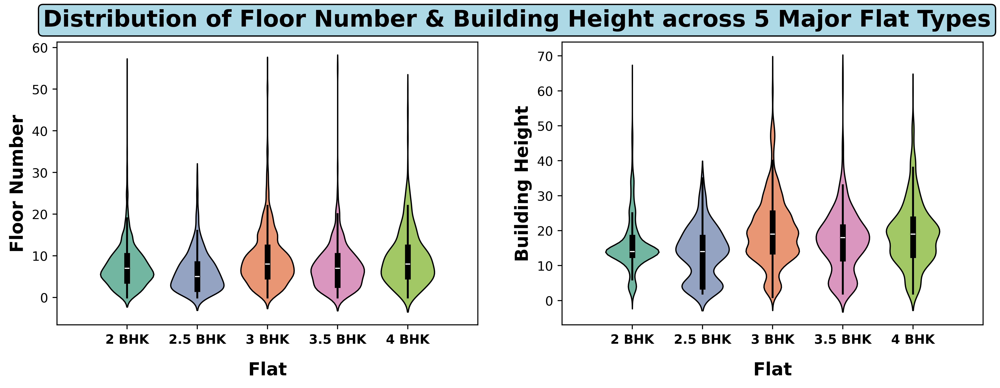

In [130]:
def Distribution_of_Floor_Number_and_Building_Height_Major_flat_types()
    ## Preparinf data for Analysis:
    five_maj_flats = ['2 BHK Flat', '2.5 BHK Flat', '3 BHK Flat', '3.5 BHK Flat', '4 BHK Flat']
    df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
    data = df[(df['Floor'] != '-') & (df['Flat'].isin(five_maj_flats))].astype({'Floor_number': 'int32',
                                                                                'Building_height': 'int32'})
    
    ## --------------------------------------------------------------------------------------------
    ## Creating Plots:
    fig = plt.figure(figsize = (13,4), dpi = 500)
    ax1 = fig.add_subplot(1,2,1)
    ax2 = fig.add_subplot(1,2,2)
    
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    fig.suptitle("Distribution of Floor Number & Building Height across 5 Major Flat Types" , 
                 fontweight = 'bold', fontsize = 18, color = 'black', ha='center', x=0.51, y=0.97, bbox=bbox)
    
    ## Plotting Violin plot for Floor Number vs Flats in ax1:
    sns.violinplot(data=data, y='Floor_number', x='Flat', hue='Flat', ax=ax1, palette='Set2' ,
                   order = five_maj_flats, width=0.8, gap=0.05, linewidth=1, linecolor='black', cut=2)
    
    ax1.set_xlabel("Flat", fontsize = 14, fontweight = 'bold', labelpad = 12)
    ax1.set_ylabel("Floor Number", fontsize = 14, fontweight = 'bold')
    
    ax1.set_xlim(-1, 5)
    ax1.set_xticks(list(range(0, 5)))
    ax1.set_xticklabels([i[:-5] for i in five_maj_flats], fontsize = 10, fontweight = 'bold')
    
    ## Plotting Violin plot for Building Height vs Flats in ax2:
    sns.violinplot(data=data, y='Building_height', x='Flat', hue='Flat', ax=ax2, palette='Set2' ,
                   order = five_maj_flats, width=0.8, gap=0.05, linewidth=1, linecolor='black', cut=2)
    
    ax2.set_xlabel("Flat", fontsize = 14, fontweight = 'bold', labelpad = 12)
    ax2.set_ylabel("Building Height", fontsize = 14, fontweight = 'bold')
    
    ax2.set_xlim(-1, 5)
    ax2.set_xticks(list(range(0, 5)))
    ax2.set_xticklabels([i[:-5] for i in five_maj_flats], fontsize = 10, fontweight = 'bold')
    
    plt.show()

Distribution_of_Floor_Number_and_Building_Height_Major_flat_types()

### **`🔍 OBSERVATIONS :`**
* **`Floor Number Distribution (left plot):`**
  * **All flat types** are **concentrated in** the **lower to mid floors (0–15 range)**.
  * **3 BHK and 4 BHK flats** show a **wider spread**, with units found even at higher floors (up to 50+).
  * **2.5 BHK and 3.5 BHK** have **tighter distributions**, mostly **within 0–15 floors**.<br><br>
* **`Building Height Distribution (right plot):`**
  * **Most buildings across flat types** are **10–25 floors tall**, with **medians clustered around 15–20 floors**.
  * **3 BHK and 4 BHK** flats are more **commonly present** in **taller buildings (20–40+ floors)**.
  * **2 BHK and 2.5 BHK** flats are **more concentrated in smaller-to-mid height buildings** **(5–20 floors)**.


### **`💡 Interpretation`**
* **3 BHK and 4 BHK flats dominate taller high-rise projects**, reflecting their **positioning in premium** or large-scale developments.
* **Smaller units (2 BHK & 2.5 BHK)** are **largely** in **mid-rise buildings**, indicating **alignment with affordability-driven buyers**.
* The **floor number distribution skews toward Lower-Mid levels** for all types, **highlighting common buyer preference for mid-level living**.
* Wider spread in higher floor availability for larger flats indicates **luxury and exclusivity factors**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Buyers **seeking affordability** should expect **2 BHKs in mid-rise projects**.
  * Those **preferring higher floors with better views** will find more availability in **3 BHK/4 BHK high-rise towers**.
* **Developers:**
  * **Market aligns** well **with mid-rise developments** for **small units**, but **luxury positioning of larger units in high-rises** is a **clear trend**.
  * **Floor distribution** insights can **help design pricing strategies** (e.g., premium for higher floors in larger flats).
* **Investors:**
  * **Mid-level 2 & 2.5 BHKs** may offer stronger rental demand.
  * **Higher-floor 3 & 4 BHKs** could yield better resale value due to exclusivity and premium appeal.

---

### **`✅ CONCLUSION :`**
The analysis shows a **clear segmentation by flat type and building scale**:<br>
- **Smaller units** (2 & 2.5 BHK) are **concentrated in mid-rise buildings** with **lower floors**, while
- **Larger flats** (3 & 4 BHK) extend into **taller towers** and **higher floors**, reflecting their **luxury and premium positioning**.<br><br>
**Across all flat types**, the preference for **mid-level floors (5–15)** **remains consistent**, aligning with market demand for practical and comfortable living.

---

#### **`❓ Is there any irregularity in distributions?`**
✅ Yes, there are some **long tails and irregular spreads**:<br>
* **3 BHK and 4 BHK** show **extended tails into very high floors/buildings (50–60+)**, highlighting luxury projects.
* **2.5 BHK and 3.5 BHK** have **compressed distributions**, indicating limited supply and niche positioning.

<br><br>

---
# **`H.` How does the Floor Number affects Property Pricing?**
- Does higher floors command premium pricing?
- How much premium does buyer need to pay, for premium floors?

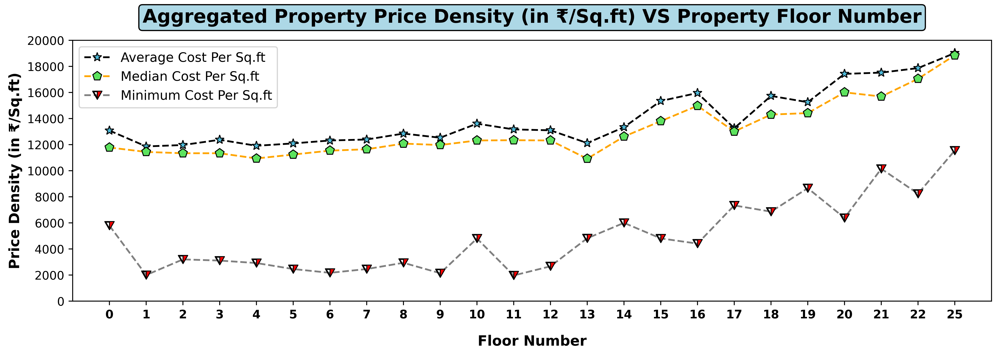

In [152]:
def Floor_Number_affects_Property_Pricing():
    ## Preparinf data for Analysis:
    df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
    data = df[df['Floor'] != '-'].astype({'Floor_number': 'int32', 'Building_height': 'int32'})
    
    ## Grouping data based on Floor Number and finding mean and median "Property Price Per Sqft" 
    ## for each of the group:
    def func_bed(data):
        pro_pri = data['Avg_price_rupee_per_sqft']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data = data.groupby(by = 'Floor_number').apply(func_bed).astype({('Price', 'tot_prop_listed'):'int32'})
    data = data.reset_index()
    
    ## Selecting Floors with atleast 35 listings:
    data = data[data[('Price', 'tot_prop_listed')] > 35]
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (14,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.plot(data['Floor_number'].astype(str), data[('Price', 'mean')], linewidth=1.5, color='black', linestyle='--',
            label = 'Average Cost Per Sq.ft', marker = '*', markersize  = 8,  markerfacecolor='#4EBAD9',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Floor_number'].astype(str), data[('Price', 'median')], color='orange', linestyle='--',
            linewidth=1.5, label = 'Median Cost Per Sq.ft', marker = 'p', markersize  = 8, 
            markerfacecolor='#5DE35E',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Floor_number'].astype(str), data[('Price', 'min')], linewidth=1.5, color='grey', linestyle='--',
            label = 'Minimum Cost Per Sq.ft', marker = '$⧩$', markersize  = 8,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Aggregated Property Price Density (in ₹/Sq.ft) VS Property Floor Number', 
                 fontsize=16, fontweight='bold', bbox = bbox, pad = 15)
    ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=12, fontweight='bold')
    ax.set_xlabel('Floor Number', fontsize=12, fontweight='bold', labelpad = 12)
    
    ax.set_xlim(-1, 24)
    ax.set_xticks(list(range(0, 24)))
    ax.set_xticklabels(data['Floor_number'].astype(str), fontsize = 10, fontweight = 'bold')
    
    ax.set_ylim(0,20000)
    ax.set_yticks(list(range(0, 20001, 2000)))
    
    ax.legend(fontsize=11, loc = 'upper left')
    plt.show()

Floor_Number_affects_Property_Pricing()

### **`🔍 OBSERVATIONS :`**
* **Median and Average Price Density** show a **clear upward trend** with increasing floor numbers.
* **Ground and low floors (0–5)** have **median price density** around **₹11K–12K/Sq.ft**.
* **Mid-level floors (10–15)** **rise moderately** to **₹13K–14.5K/Sq.ft**.
* **Premium/high floors (20–25)** show the **highest density**, reaching **₹18K–19K/Sq.ft**.
* **Minimum cost per Sq.ft** also **increases with higher floors**, indicating **even budget options** (like 2 BHK) are **costlier on premium floors**.


### **`💡 Interpretation`**
* **Higher floors command a price premium**, consistent with buyer demand for better views, privacy, ventilation, and reduced noise.
* The **price gap between lower and higher floors is significant**, showing that **floor positioning is a *KEY DETERMINANT*** of price density in Gurugram.
* Developers are effectively pricing higher floors as a **luxury/aspirational feature**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Buyers **seeking affordability** should **prefer lower/mid floors**.
  * Buyers looking **for premium experience** must be prepared to **pay substantially higher per Sq.ft rates** on upper floors.
* **Developers:**
  * Floor-rise pricing strategy is justified, with strong demand sustaining higher per Sq.ft values.
  * **High-rise projects** can leverage **premium pricing for upper floors** to **boost profitability**.
* **Investors:**
  * Investing in mid-to-high floors offers better resale potential due to sustained **floor-rise premium**.
  * Rental yields may also improve on higher floors, especially in expat/corporate markets.

---

### **`✅ CONCLUSION :`**
The analysis shows a **direct and significant positive correlation between floor number and property price density**. **Higher floors** command **clear premiums**, with **median costs rising from ~₹11K/Sq.ft at lower floors to nearly ₹19K/Sq.ft at premium levels**. This **validates** the **floor-rise pricing model** widely adopted in Gurugram’s real estate market.

---

#### **`❓ Answers to Few Questions :`**
#### **Does higher floors command premium pricing?**
- ✅ **YES** — **higher floors** consistently show **higher ₹/Sq.ft values**.

#### **How much premium does buyer need to pay, for premium floors?**
- 📈 Buyers typically pay **~ 50–70% higher price density** (₹6K–7K/Sq.ft more) on **20th+ floors** compared to lower floors.

<br><br>

---
# **`I.` Do higher floors in taller buildings command Premium Pricing?**
- Categories Buildings based on their height.
- And then Floors based on relative position in the Building.

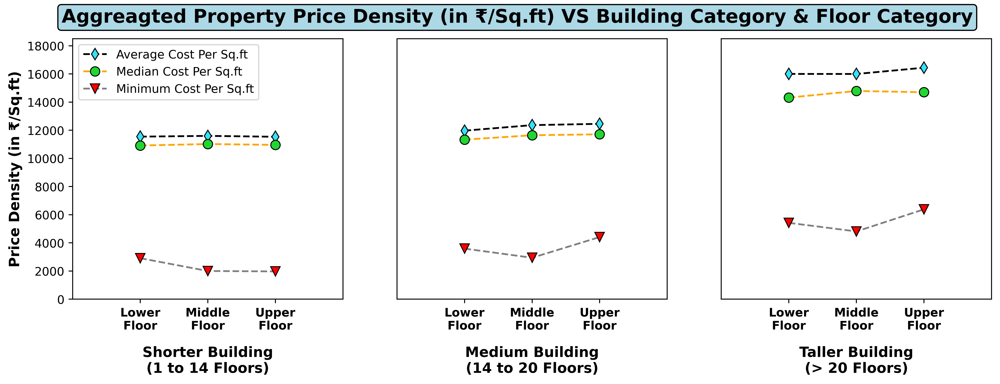

In [168]:
def Do_higher_floors_in_taller_buildings_command_Premium_Pricing():
    ## Preparing data for Analysis:
    df['Floor_number'].replace({'Ground Floor' : '0'}, inplace = True)
    data = df[df['Floor'] != '-'].astype({'Floor_number': 'int32', 'Building_height': 'int32'})
    
    ## Lets Categorise Buildings based on their Total Floor Heights:
    thresh_1 = np.percentile(data['Building_height'], 33.33).astype('int32')   ## i.e., 14
    thresh_2 = np.percentile(data['Building_height'], 66.66).astype('int32')   ## i.e., 20
    
    def building_categorizer(height, thresh_1, thresh_2):
        if height <= thresh_1:
            return "Shorter Building"                    ## Height between 1 to 14
        elif height > thresh_1 and height <= thresh_2:
            return "Medium Building"                     ## Height between 14 to 20
        else:
            return "Taller Building"                     ## Height greater than 20
    
    data['Building_cate'] = data['Building_height'].apply(building_categorizer, thresh_1=thresh_1, 
                                                          thresh_2=thresh_2)
    
    ## Now, lets categorize Floor of a Building based on the position of Floor in the building:
    def floor_categorizer(data):
        height = data['Building_height']
        floor = data['Floor_number']
        
        if floor <= (1/3) * height:
            return 'Lower Floor'                                 ## Floor in lower 1/3rd part
        elif floor > (1/3) * height and floor <= (2/3) * height:
            return 'Middle Floor'                                ## Floor in middle 1/3rd part
        else:
            return 'Upper Floor'                                 ## Floor in upper 1/3rd part
    
    data['Floor_cate'] = data[['Floor_number', 'Building_height']].apply(floor_categorizer, axis=1)
    
    ## Now we just need to Groo by data based on Building Category and Floor Category and 
    ## get Aggregated Cost Per Sqft:
    
    def func_floo(data):
        pro_pri = data['Avg_price_rupee_per_sqft']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data = data.groupby(by=['Building_cate', 'Floor_cate']).apply(func_floo).astype({('Price', 
                                                                               'tot_prop_listed'):'int32'})
    data = data.reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (14,4), dpi = 500)
    ax1 = fig.add_subplot(1,3,1)
    ax2 = fig.add_subplot(1,3,2)
    ax3 = fig.add_subplot(1,3,3)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    fig.suptitle("Aggreagted Property Price Density (in ₹/Sq.ft) VS Building Category & Floor Category" , 
                 fontweight = 'bold', fontsize = 16, color = 'black', ha='center', x=0.5, y=0.97, bbox=bbox)
    
    axes = [ax1, ax2, ax3]   ##Creating a list of all axes objects...
    
    building_categories = ['Shorter Building', 'Medium Building', 'Taller Building']
    building_labels = ['Shorter Building\n(1 to 14 Floors)', 'Medium Building\n(14 to 20 Floors)', 
                           'Taller Building\n(> 20 Floors)']
    
    for ax, building_category, building_label in zip(axes, building_categories, building_labels):
        temp = data[data['Building_cate'] == building_category]
        
        ax.plot(temp['Floor_cate'], temp[('Price', 'mean')], linewidth=1.5, color='black', 
                linestyle='--', label='Average Cost Per Sq.ft', marker='d', markersize=7,  
                markerfacecolor='#36E1F7', markeredgecolor='black', markeredgewidth = 0.8)
        
        ax.plot(temp['Floor_cate'], temp[('Price', 'median')], color='orange', linestyle='--',
                linewidth=1.5, label = 'Median Cost Per Sq.ft', marker = 'o', markersize  = 8, 
                markerfacecolor='#22D631',markeredgecolor='black', markeredgewidth = 0.8)
        
        ax.plot(temp['Floor_cate'], temp[('Price', 'min')], linewidth=1.5, color='grey', 
                linestyle='--', label='Minimum Cost Per Sq.ft', marker='v', markersize=8,  
                markerfacecolor='red',markeredgecolor='black', markeredgewidth = 0.8)
    
        ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=12, fontweight='bold')
        ax.set_xlabel(building_label, fontsize=12, fontweight='bold', labelpad = 12)
        
        ax.set_xlim(-1, 3)
        ax.set_xticks(list(range(0, 3)))
        ax.set_xticklabels([i.split()[0] + '\n' + i.split()[1] for i in temp['Floor_cate'].values], 
                           fontsize = 10, fontweight = 'bold')
        
        ax.set_ylim(0,18500)
        ax.set_yticks(list(range(0, 18001, 2000)))
        
    #ax1.set_yticks(range(0, 18000, 2000))
    ax1.set_yticklabels(list(range(0, 18001, 2000)), fontsize = 10)    
    ax2.get_yaxis().set_visible(False)
    ax3.get_yaxis().set_visible(False)
    
    ax1.legend(fontsize=10, loc = 'upper left')
    plt.show()

Do_higher_floors_in_taller_buildings_command_Premium_Pricing()

### **`🔍 OBSERVATIONS :`**
* **Shorter Buildings (1–14 floors):** **Price density** remains **largely flat across lower, middle, and upper floors (~ ₹11K–12K/Sq.ft)**, with negligible premium.
* **Medium Buildings (14–20 floors):** **Price density rises slightly** for **upper floors (~ ₹12.5K/Sq.ft)** compared to **lower (~ ₹12K/Sq.ft)**.
* **Taller Buildings (>20 floors):** **Strong premium observed**, with **upper floors averaging ~ ₹16.5K/Sq.ft**, significantly **higher than lower floors (~ ₹15K/Sq.ft)**.
* **Minimum cost values** follow a similar pattern, **increasing with building height** and **floor level**.


### **`💡 Interpretation`**
* **Floor-rise Premium Effect depends on Building Height:**
  * **Minimal** in **shorter buildings**.
  * **Noticeable** in **medium buildings**.
  * **Strong and consistent** in **taller towers**.
* **Buyers in luxury high-rises** clearly associate **higher floors with exclusivity, better views, and lifestyle value**, justifying **higher pricing**.
* Developers are leveraging **floor-rise pricing models** more aggressively **in high-rise projects**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * In **shorter projects**, **floor choice** can be **based on preference rather than price** sensitivity.
  * In **taller towers**, buyers should **expect** a **clear premium for upper floors**.
* **Developers:**
  * **Pricing strategies** should be **uniform for shorter projects** but **floor-differentiated for high-rises**.
  * Highlighting lifestyle and view benefits in marketing can justify premiums in tall towers.
* **Investors:**
  * Upper floors in taller buildings offer **higher appreciation potential** due to sustained demand.
  * Mid-level floors may offer a **balance between cost and resale liquidity**.

---

### **`✅ CONCLUSION :`**
The analysis reveals that **Floor-rise Premium is strongly correlated with Building Height**. In **shorter buildings**, **pricing** is **almost uniform across floors**. In **medium-rise projects**, a **modest premium emerges**, while in **taller towers**, **upper floors command a significant premium (₹1.5K–2K/Sq.ft higher)**. This **reinforces** that **Floor-rise Pricing is a key differentiator in luxury high-rise developments**, while being **less relevant in shorter projects**.

<br><br>

<br>

----
----
#### **`Lets inspect 'Parking' features in data - "Open Parking" & "Covered Parking" :`**
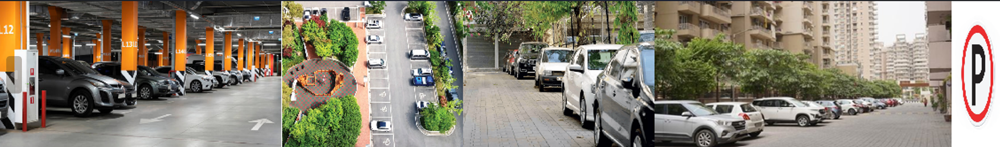
+ Distribution of Parking across listings and its both types.
+ Most Frequent Parkings in both the Parking Types?
+ Is there any skew in distribution?

<br>

# **`J.` Distribution of Parking across listings and its types.**

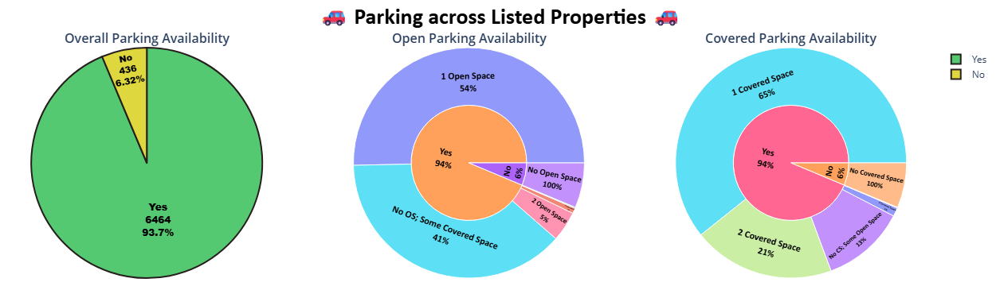


PARKING STATS :


Total Property Listed Percentage Total Open Parking Spaces  \
                                                                           0   
Parking_available                                                              
Yes                                6464           93.68%                2638   
No                                  436            6.32%                 436   

                                    Covered Parking Spaces                     \
                      1    2   3  4                      0     1     2   3  4   
Parking_available                                                               
Yes                3473  292  52  9                    810  4192  1372  84  5   
No                    0    0   0  0                    436     0     0   0  0   

                      
                   6  
Parking_available     
Yes                1  
No                 0

In [217]:
def Distrubution_of_Parking_and_Types():
    ## Preparing data for analysis:
    data = df[df['Parking'] != '-']
    data["Parking_available"] = data['Parking'].apply(lambda x: "Yes" if x != 'No Parking' else 'No')
    
    data['Open_parking'].replace({'0':"No Open Space", '1':"1 Open Space", '2':"2 Open Space",
                                 '3':"3 Open Space", '4':"4 Open Space"}, inplace=True)
    data['Open_parking'] = np.where(((data['Parking_available'] == 'Yes') & (data['Open_parking'] == 'No Open Space')),
                                  "No OS; Some Covered Space", data['Open_parking'])
    
    data['Covered_parking'].replace({'0':"No Covered Space", '1':"1 Covered Space", '2':"2 Covered Space",
                                  '3':"3 Covered Space", '4':"4 Covered Space", '5':"5 Covered Space",
                                  '6':"6 Covered Space"}, inplace=True)
    data['Covered_parking'] = np.where(((data['Parking_available'] == 'Yes') & (data['Covered_parking'] == 'No Covered Space')),
                                  "No CS; Some Open Space", data['Covered_parking'])
  
    ## -----------------------------------------------------------------------------------------------
    ## Creating Plots:
    fig_main = make_subplots(
        rows=1, cols=3,
        specs=[[{'type':'domain'}, {'type':'sunburst'}, {'type':'sunburst'}]],
        subplot_titles=['<b>Overall Parking Availability</b>', '<b>Open Parking Availability</b>', 
                        '<b>Covered Parking Availability</b>'])
    
    ## Pie Chart: -------------------------------------------
    trace = go.Pie(values = data['Parking_available'].value_counts(), 
                   labels = data['Parking_available'].value_counts().index,
                   direction='counterclockwise', textinfo='label+value+percent',
                  marker=dict(colors=['#54C971', '#DED73E'],  # Custom colors
                              line=dict(color='#261F1D', width=2)  # Border color and width
                             ),
                  textfont=dict(family='Arial Black', color='black', size=12), textposition='inside',
                  hovertemplate="Parking Available: %{label}<br>Property Count : %{value}<br>Tot. Percent: %{percent}<extra></extra>")
    
    fig_main.add_trace(trace, row=1, col=1)
    
    ## 1st Sunburst - Open Parking: -------------------------------------------
    sun1_trace = px.sunburst(data, path=['Parking_available','Open_parking'], values=np.ones(data.shape[0]), 
                      color='Open_parking', color_continuous_scale='Reds')
    
    sun1_trace.update_traces(textinfo="label+percent parent",
                          hovertemplate='<b>%{label}</b><br>Tot. Listings: %{value}<br>Parking Available: %{parent}<extra></extra>',
                          textfont=dict(size=12, color="black", family="Calibri black"))
    
    for trace in sun1_trace.data:
        fig_main.add_trace(trace, row=1, col=2)
    
    ## 1st Sunburst - Open Parking: -------------------------------------------
    sun2_trace = px.sunburst(data, path=['Parking_available','Covered_parking'], 
                             values=np.ones(data.shape[0]), color='Covered_parking', 
                             color_continuous_scale='Reds')
    
    sun2_trace.update_traces(textinfo="label+percent parent",
                          hovertemplate='<b>%{label}</b><br>Tot. Listings: %{value}<br>Parking Available: %{parent}<extra></extra>',
                          textfont=dict(size=12, color="black", family="Calibri black"))
    
    for trace in sun2_trace.data:
        fig_main.add_trace(trace, row=1, col=3)
    
    ## ----------------------------------
    fig_main.update_layout(autosize=True, margin=dict(l=20, r=20, t=60, b=10),
                          title=dict(text="<b>🚗 Parking across Listed Properties 🚗</b>",
                                     font=dict(size=28, color="black", family='Calibri'),
                                     x = 0.5,  # center title
                                     pad=dict(t=50, b=50, l=20, r=20)),paper_bgcolor='white')
    
    fig_main.show()

Distrubution_of_Parking_and_Types()

## -----------------------------------------------------------------------------------------------------
## Preparing stats of PARKING:
data = df[df['Parking'] != '-'].astype({'Covered_parking': 'int32', 'Open_parking': 'int32'})
data["Parking_available"] = data['Parking'].apply(lambda x: "Yes" if x != 'No Parking' else 'No')

## Finding Parking distribution across listed proeprties:
open_parking = data.groupby(by=['Parking_available', 'Open_parking']).apply(lambda x: 
                                                       x.shape[0]).unstack().fillna(0).astype('int32')

covered_parking = data.groupby(by=['Parking_available', 'Covered_parking']).apply(lambda x: 
                                                   x.shape[0]).unstack().fillna(0).astype('int32')

## Creating MultiIndex for Column Labels:
multi_in_open = [i for i in zip(['Open Parking Spaces'] * len(open_parking.columns), 
                               open_parking.columns.to_list())]
multi_in_covered = [i for i in zip(['Covered Parking Spaces'] * len(covered_parking.columns), 
                               covered_parking.columns.to_list())]

open_parking.columns = pd.MultiIndex.from_tuples(multi_in_open)
covered_parking.columns = pd.MultiIndex.from_tuples(multi_in_covered)

## Final DF of Stats:
parking_stats = pd.concat([open_parking, covered_parking], axis = 1).sort_index(ascending = False)
parking_stats.insert(0, 'Total Property Listed' , data["Parking_available"].value_counts())
parking_stats.insert(1, 'Percentage Total' , 
                     round(data["Parking_available"].value_counts(normalize=True
                                                                 ) * 100, 2).astype(str) + '%')
print("\nPARKING STATS :")
parking_stats

### **`🔍 Quick Observations :`**
* **`Overall Parking Availability:`**
  * **94% (6,464 properties)** provide **some form of parking**.
  * Only **6% (436 properties)** do not offer parking at all.
* **`Open Parking:` *{across properties with Parking available}***
  * Majority (**54%**) have **1 open parking space**.
  * **41%** have **no open parking** (*but have some covered parking space instead*).
  * **Only 5%** of properties provide **2 open spaces**.
  * **Very few** offer **more than 2 open slots**.
* **`Covered Parking:` *{across properties with Parking available}***
  * **65%** of properties have **1 covered space**.
  * **21%** have **2 covered spaces**, **mostly premium properties**.
  * **13%** have **no covered parking** (*but have some open space*).
  * **Very rare cases** provide **3+ covered slots (luxury category)**.
* **`Absolute Numbers (from stats table):`**
  * **Open Parking:** 3,473 (1 slot), 292 (2 slots), 52 (3 slots), 9 (4 slots).
  * **Covered Parking:** 4,192 (1 slot), 1,372 (2 slots), 84 (3 slots), 5 (4 slots), 1 (6 slots).
  * **Only 9 properties** are listed where **most number of Open Parking space** i.e., **4** is provided.
  * **Only 1 property** listed where **most number of Covered Parking space** i.e., **6** is provided.


### **`💡 Interpretation`**
* **Parking** availability is a **standard amenity** (as 94% of properties provide it) in Gurugram real estate.
* **1 parking slot (open or covered)** is the **most common provision**.
* **2 or more slots** are **clearly** associated with **higher-end/luxury properties**.
* Properties without parking form a **minor segment (older or budget projects)**.

---

### **`✅ Conclusion :`**
Parking is almost **universally available in Gurugram flats (94%)**, with **1-slot availability** as the **market norm**. **Multiple slots** act as a **premium differentiator for larger or luxury flats**. Properties without parking (~6%) are exceptions, expected typically in older or budget segments, reinforcing that **buyers today expect parking as a baseline feature**.

<br><br>

---
# **`K.` Availability of Parking Spaces across 5 Major Flat Types.**
- Does certain Parking type is tied with certain BHK type?
- Is there any skew in parking distribution across flats?

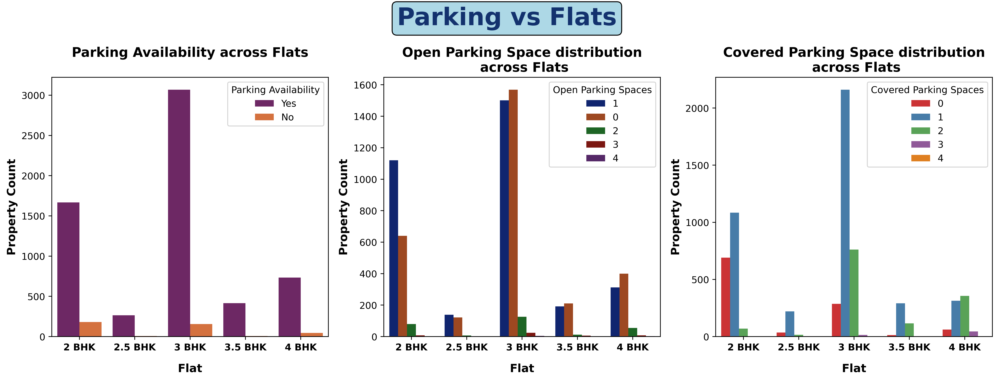

In [231]:
def Parking_Spaces_across_5_Major_Flat_Types():
    ## Preparing data for analysis:
    five_maj_flat = ['2 BHK Flat', '2.5 BHK Flat', '3 BHK Flat', '3.5 BHK Flat', '4 BHK Flat']
    data = df[(df['Flat'].isin(five_maj_flat)) & (df['Parking'] != '-')]
    data["Parking_available"] = data['Parking'].apply(lambda x: "Yes" if x != 'No Parking' else 'No')
    
    ## Creating plot: -----------------------------------------------------------------------------------
    fig = plt.figure(figsize = (18,5), dpi = 500)
    ax1 = fig.add_subplot(1,3,1)
    ax2 = fig.add_subplot(1,3,2)
    ax3 = fig.add_subplot(1,3,3)
    axes = [ax1, ax2, ax3]
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    fig.suptitle("Parking vs Flats", fontweight = 'bold', fontsize = 26, color = '#13326E', ha='center', 
                 x=0.5, y=1.09, bbox=bbox)
    
    sns.countplot(data=data, x='Flat', hue='Parking_available', ax=ax1, order=five_maj_flat,palette='inferno')
    sns.countplot(data=data, x='Flat', hue='Open_parking', ax=ax2, order=five_maj_flat, palette='dark')
    sns.countplot(data=data, x='Flat', hue='Covered_parking', ax=ax3, order=five_maj_flat, palette='Set1')
    
    titles = ['Parking Availability across Flats\n', 'Open Parking Space distribution\n across Flats', 
              'Covered Parking Space distribution\n across Flats']
    
    for ax, title in zip(axes, titles):
        ax.set_title(title, fontsize=14, fontweight='bold')
        ax.set_ylabel('Property Count', fontsize=12, fontweight='bold')
        ax.set_xlabel('Flat', fontsize=12, fontweight='bold', labelpad = 12)
        
        ax.set_xticks(list(range(0, 5)))
        ax.set_xticklabels([i[:-5] for i in five_maj_flat], fontsize = 10, fontweight = 'bold')
    
    ax1.legend(title="Parking Availability")
    ax2.legend(title="Open Parking Spaces")
    ax3.legend(title="Covered Parking Spaces")
    
    plt.show()

Parking_Spaces_across_5_Major_Flat_Types()

### **`🔍 OBSERVATIONS :`**
* **`Parking Availability (left chart):`**
  * **Almost all flats** across types **provide parking**, with **3 BHK and 2 BHK flats leading** (just becuase they dominate in total property listings) in numbers.
  * **Very few flats across categories lack parking**, indicating strong market compliance.
* **`Open Parking Distribution (middle chart):`**
  * **2 BHK and 3 BHK flats** dominate **open parking** provisions.
  * The majority have **1 open space**, while **0 open space** is **also common**, **reflecting reliance on covered parking**.
  * **Very few flats** (mostly larger ones) provide **2+ open slots**.
* **`Covered Parking Distribution (right chart):`**
  * **3 BHK flats** strongly **dominate covered parking** availability, often with **1 or 2 slots**.
  * **4 BHK flats** show **higher chances** of **2+ covered spaces**, indicating **premium positioning**.
  * **2 BHK flats** show a mix, with many having **0 or 1 covered space**, reflecting affordability-driven developments.


### **`💡 Interpretation`**
* **3 BHK flats are the most balanced**, with **strong availability of both open and covered parking**, making them **attractive for family buyers**.
* **2 BHK flats lean toward affordability**, with **more reliance on open** or **limited covered parking**.
* **4 BHK flats emphasize premium living**, with **multiple covered slots**, aligning **with luxury positioning**.
* **2.5 BHK and 3.5 BHK flats** are smaller segments, with moderate parking provision, **positioned between economy and premium**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Buyers of **2 BHKs** may face **limited covered parking** and should **evaluate open space options**.
  * **4 BHK buyers** can expect **multiple covered slots** as part of the **luxury offering**.
  * **3 BHK buyers** get the **best balance of open + covered parking**.
* **Developers:**
  * **Parking allocation** is **clearly tied to flat size** — ***larger flats get more covered slots***.
  * For mid-sized flats (2.5/3.5 BHK), improving parking availability could boost appeal.
* **Investors:**
  * Flats with **covered parking, especially multiple slots**, have higher **resale and rental demand**.
  * Limited/no parking flats may face challenges in long-term appreciation.

---

### **`✅ CONCLUSION :`**
Parking distribution is **closely linked with flat type**. **2 BHKs are affordability-driven**, often **with limited parking**; **3 BHKs dominate in both open and covered availability**; and **4 BHKs enjoy premium allocation with multiple covered slots**. **Parking** provision thus **acts as** a **clear differentiator of affordability vs premium positioning** across Gurugram flats.

---

#### **`❓ Some Quick Questions :`**
#### **Does certain Parking type tie with certain BHK type?**
+ ✅ **YES**. **2 BHKs → limited/open parking**, **3 BHKs → balanced open + covered**, **4 BHKs → multiple covered (premium)**.

#### **Is there any skew in parking distribution across flats?**
+ ✅ **YES**. There is a **clear skew toward 3 BHK flats**, which dominate parking availability overall, while **premium parking (multiple slots)** is concentrated in **4 BHKs**.

<br><br>

---
# **`L.` How does availability of Parking affect Property Pricing?**

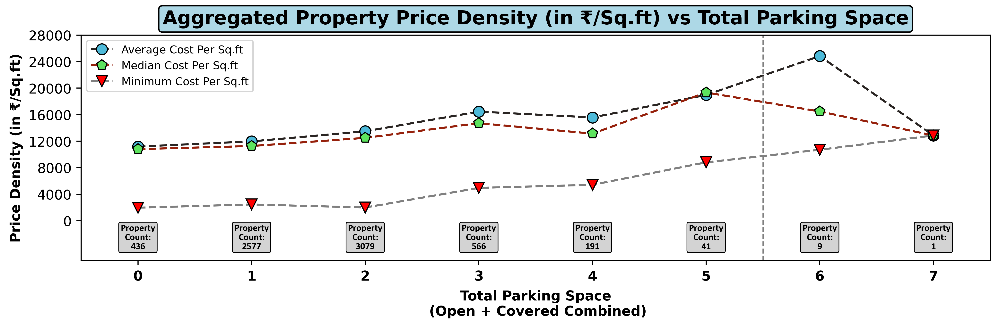

In [245]:
def Parking_VS_Property_Pricing():
    ## Preparing data for analysis:
    data = df[df['Parking'] != '-'].astype({'Covered_parking': 'int32', 'Open_parking': 'int32'})
    data['Tot_parking_space'] = data['Open_parking'] + data['Covered_parking']
    
    ## Grouping data based on Floor Number and finding mean and median "Property Price Per Sqft" 
    ## for each of the group:
    def func_price(data):
        pro_pri = data['Avg_price_rupee_per_sqft']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data = data.groupby(by = 'Tot_parking_space').apply(func_price).astype({('Price', 
                                                                             'tot_prop_listed'):'int32'})
    data = data.reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (12,3), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.plot(data['Tot_parking_space'].astype(str), data[('Price', 'mean')], linewidth=1.5, color='#292422', 
            linestyle='--', label = 'Average Cost Per Sq.ft', marker = 'o', markersize  = 8,  
            markerfacecolor='#4EBAD9', markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Tot_parking_space'].astype(str), data[('Price', 'median')], color='#96210C', linestyle='--',
            linewidth=1.5, label = 'Median Cost Per Sq.ft', marker = 'p', markersize  = 8, 
            markerfacecolor='#5DE35E',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Tot_parking_space'].astype(str), data[('Price', 'min')], linewidth=1.5, color='grey', 
            linestyle='--', label = 'Minimum Cost Per Sq.ft', marker = 'v', markersize  = 8,  
            markerfacecolor='red', markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.axvline(5.5, color='grey', linestyle='--', linewidth=1)
    
    ax.set_title('Aggregated Property Price Density (in ₹/Sq.ft) vs Total Parking Space', 
                 fontsize=14, fontweight='bold', bbox = bbox, pad = 8)
    ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=10, fontweight='bold')
    ax.set_xlabel('Total Parking Space\n (Open + Covered Combined)', fontsize=10, fontweight='bold', labelpad = 5)
    
    ax.set_xlim(-0.5, 7.5)
    ax.set_xticks(list(range(0, 8)))
    ax.set_xticklabels(data['Tot_parking_space'].astype(str), fontsize = 10, fontweight = 'bold')
    
    ax.set_ylim(-6000,28000)
    ax.set_yticks(list(range(0, 28001, 4000)))
    
    ## Annotate Property Count:
    for prop_count, num_bal in zip(data[('Price', 'tot_prop_listed')], sorted(data['Tot_parking_space'].unique())):
        ax.text(num_bal, -2500, f"Property\nCount:\n{prop_count}", ha='center', va='center', fontsize=7, 
                fontweight='bold', fontfamily='Calibri', color='black', 
                bbox={'facecolor': 'lightgrey', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                      'linewidth': 0.6} )
    
    ax.legend(fontsize=8, loc = 'upper left')
    plt.show()

Parking_VS_Property_Pricing()

### **`🔍 OBSERVATIONS :`**
* **General Trend:** As **total parking spaces (open + covered) increases**, the **average and median property price density (₹/Sq.ft)** also **increases**.
* **No Parking (0 spaces):** Properties without parking **still show** a **reasonable price density** (~ ₹11,000/Sq.ft) but are **fewer in number** (**436 properties**).
* **1–2 Parking Spaces:** The **bulk of properties fall** here (**>5,600 combined**), with price density averaging **₹11K–13K/Sq.ft**.
* **3–5 Parking Spaces:** Properties with **3–5 spaces** show a **clear jump**, averaging **₹15K–19K/Sq.ft**.
* **6–7 Parking Spaces:** Very rare category (only 9 with 6 slots, 1 with 7 slots), but they **command** the **highest premium (~₹25K+/Sq.ft for 6 slots)**, showing **luxury positioning**.


### **`💡 Interpretation`**
* **Parking** availability is ***Positively Correlated* with property price density**.
* **More parking spaces** are an **indicator of luxury and exclusivity** in Gurugram’s real estate market.
* Properties with **multiple parking slots (≥3)** are **targeted at high-net-worth buyers**, where **parking** is **bundled as** a **premium amenity**.
* The **sharp rise in density beyond 3 slots** shows that **buyers perceive multiple parking as a strong value addition**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Buyers **seeking affordability** will find **1–2 slot properties sufficient**, with moderate price densities.
  * **Luxury buyers** should **expect to pay** a **substantial premium for 3+ slots**.
* **Developers:**
  * Providing **extra parking spaces** can act as a **premium feature**, justifying higher prices.
  * Marketing should **highlight parking availability as** a **luxury differentiator** in premium projects.
* **Investors:**
  * Properties with **3+ slots** show strong appreciation potential, **being limited and in high demand**.
  * Standard 1–2 slot properties remain the **most liquid segment** for resale.

---

### **`✅ CONCLUSION :`**
**Parking** availability is **not just a utility** but a ***Price Driver*** in Gurugram real estate. Properties with **1–2 slots dominate the market**, but those with **3 or more slots command steep premiums**, pushing price density significantly higher. This **reflects** a clear **luxury signal**, where **abundant parking is tied to exclusivity** and higher market valuation.

<br><br>

---
# **`M.` Comparing Prices for properties with Covered vs Open Parking.**
- Which parking type adds premium to property cost?
- Does properties with combined parking availability command better prices?

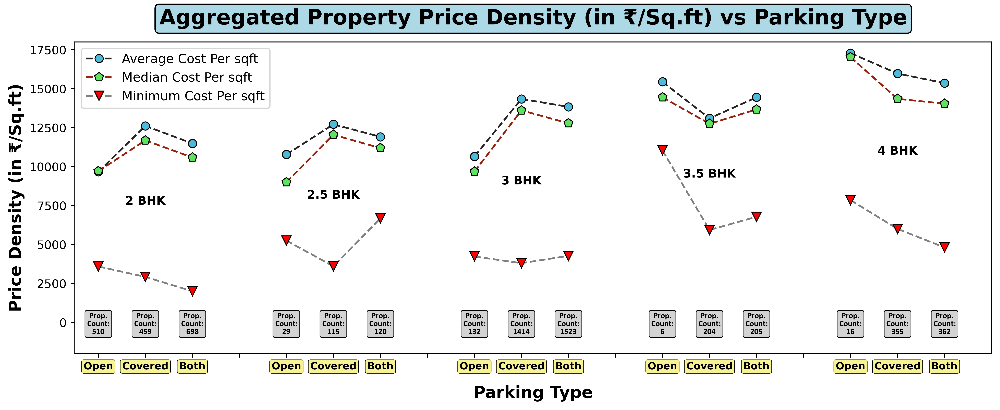

In [377]:
def Comparing_Prices_for_properties_with_Covered_vs_Open_Parking():
    ## Preparing data for analysis:
    five_maj_flat = ['2 BHK Flat', '2.5 BHK Flat', '3 BHK Flat', '3.5 BHK Flat', '4 BHK Flat']
    data = df[(df['Flat'].isin(five_maj_flat)) & (df['Parking'] != '-')].astype({'Covered_parking': 'int32', 
                                                                                 'Open_parking': 'int32'})
    
    ## Grouping data based on "Flat" and finding mean and median "Property Price Per Sqft" 
    ## for each of the group:
    def func_price(data):
        open_p = data[(data['Open_parking'] != 0) & (data['Covered_parking'] == 0)]['Avg_price_rupee_per_sqft']
        covered_p = data[(data['Covered_parking'] != 0) & (data['Open_parking'] == 0)]['Avg_price_rupee_per_sqft']
        both_oc = data[(data['Covered_parking'] != 0) & (data['Open_parking'] != 0)]['Avg_price_rupee_per_sqft']
        
        open = pd.Series(["Open Parking", open_p.size, open_p.min(), open_p.max(), open_p.mean(), 
                          open_p.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'Type'), ('Price', 'tot_prop_listed'), 
                                                ('Price', 'min'), ('Price', 'max'),
                                                ('Price', 'mean'), ('Price', 'median')]))
    
        covered = pd.Series(["Covered Parking", covered_p.size, covered_p.min(), covered_p.max(), 
                             covered_p.mean(), covered_p.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'Type'), ('Price', 'tot_prop_listed'), 
                                                ('Price', 'min'), ('Price', 'max'),
                                                ('Price', 'mean'), ('Price', 'median')]))
        
        both = pd.Series(["Both Parking", both_oc.size, both_oc.min(), both_oc.max(), 
                             both_oc.mean(), both_oc.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'Type'), ('Price', 'tot_prop_listed'), 
                                                ('Price', 'min'), ('Price', 'max'),
                                                ('Price', 'mean'), ('Price', 'median')]))
        
        return pd.concat([open, covered, both], axis = 1).T
    
    data = data.groupby(by = 'Flat').apply(func_price).astype({('Price','tot_prop_listed'):'int32'})
    
    data = data.reset_index(level = 0)
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (14,4.8), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ## Designing X axis labels to create breaks for each Flat Group:
    ## Introducing Row of NaNs after every Flat group:
    nan_row = pd.DataFrame([[np.nan] * (data.shape[1])], columns=data.columns)
    pos = 3   ## start....
    
    while True:
        ## Insert row of nans
        data = pd.concat([data.iloc[:pos], nan_row, data.iloc[pos:]]).reset_index(drop=True)
        pos += 4
        if pos >= data.shape[0]:
            break
            
    x_axis_label = data.iloc[:, 0:2].apply(lambda x: np.nan if x[0] is np.nan else str(x.values), axis = 1)
    x_axis_label_new = [j if j is np.nan else i for i, j in enumerate(x_axis_label.values)]
    
    ## Plotting:
    ax.plot(x_axis_label_new, data[('Price', 'mean')].values, linewidth=1.5, color='#292422', 
            linestyle='--', label = 'Average Cost Per sqft', marker = 'o', markersize  = 7,  
            markerfacecolor='#4EBAD9', markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(x_axis_label_new, data[('Price', 'median')].values, color='#96210C', linestyle='--',
            linewidth=1.5, label = 'Median Cost Per sqft', marker = 'p', markersize  = 8, 
            markerfacecolor='#5DE35E',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(x_axis_label_new, data[('Price', 'min')].values, linewidth=1.5, color='grey', 
            linestyle='--', label = 'Minimum Cost Per sqft', marker = 'v', markersize  = 8,  
            markerfacecolor='red', markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Aggregated Property Price Density (in ₹/Sq.ft) vs Parking Type', 
                 fontsize=18, fontweight='bold', bbox = bbox, pad = 15)
    ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=14, fontweight='bold')
    ax.set_xlabel('Parking Type', fontsize=14, fontweight='bold', labelpad = 12)

    ax.set_ylim(-2000, 18000)
    ax.set_xlim(-0.5, 19)
    ax.set_xticks(list(range(0, 19)))
    
    def tick_designer(x):
        if x is np.nan:
            return ""
        else:
            x = x.split("' '")[1][:-2]
            x = x.split()[0] #+ '\n' + x.split()[1]
            return x
    
    x_axis_tick_labels = x_axis_label.apply(tick_designer)
    ax.set_xticklabels(x_axis_tick_labels, fontsize = 8.5, fontweight = 'bold',
                       bbox={'facecolor': '#F7F294', 'edgecolor': 'black', 
                             'boxstyle': 'round, pad=0.2', 'linewidth': 0.4})
    
    ## Annoting Flat Names for Readability:
    for flat, x_ in zip(five_maj_flat, [1,5,9,13,17]):
        ax.text(x_, data.iloc[x_][('Price', 'min')] + 0.5*(data.iloc[x_][('Price', 'mean')] - 
                                                           data.iloc[x_][('Price', 'min')]), flat[:-5], 
                fontsize=10, fontweight='bold', ha='center', va='center')
    
    ## Annotate Property Count:
    for prop_count, x_tick in zip(data[('Price', 'tot_prop_listed')], list(range(0, 19))):
        if pd.isna(prop_count):
            continue
        else:
            ax.text(x_tick, -100, f"Prop.\nCount:\n{int(prop_count)}", ha='center', va='center', 
                    fontsize=7, fontweight='bold', fontfamily='Calibri', color='black', 
                    bbox={'facecolor': 'lightgrey', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.25', 
                      'linewidth': 0.6} )
            
    ax.legend(fontsize=10.8, loc = 'upper left')
    plt.show()

Comparing_Prices_for_properties_with_Covered_vs_Open_Parking()

### **`🔍 OBSERVATIONS :`**
* **`2 BHK (Prop. Count: Open=510, Covered=459, Both=698):`**
  * **Covered** shows the **highest Avg (~12,500 ₹/sq.ft) and Median (~11,500 ₹/sq.ft)**, with **Both slightly lower** and **Open lowest**.
  * **Minimum cost** is **lowest for Both** (~2,000 ₹/sq.ft).
  * **Property stock** is **fairly balanced across all three** parking types.
* **`2.5 BHK (Prop. Count: Open=29, Covered=115, Both=120):`**
  * **Covered** has the **highest Avg (~12,500 ₹/sq.ft) and Median (~12,000 )**, **followed by Both**, while **Open trails** (Avg ~11,000 ₹/sq.ft).
  * **Minimum cost** is **lowest for Covered (~3,500 ₹/sq.ft)**, while **Both is higher (6,500 ₹/sq.ft)**.
  * **Stock is concentrated in Covered and Both**, with Open negligible.
* **`3 BHK (Prop. Count: Open=132, Covered=1414, Both=1523):`**
  * **Open** shows **extremely high Avg (~14,500) and Median (~13,800)**, but **property count is very low**.
  * **Covered and Both dominate in stock** and **have strong Avg (~14,000 & 13,800) and Median (~13,500 & 12,800)**.
  * **Minimum cost** is **lowest in Covered** (~3,500).
* **`3.5 BHK (Prop. Count: Open=6, Covered=204, Both=205):`**
  * **Open** shows the **highest Avg (~15,500) and Median (~14,500)**, but with **just 6 properties**.
  * **Covered** and **Both** (main clusters) show **strong Avg (~13,000–14,000) and Median (~12,500–13,500)**.
  * **Minimum cost** is **lowest for Covered (~4,000)**.
* **`4 BHK (Prop. Count: Open=16, Covered=355, Both=362):`**
  * **Open** again shows **very high Avg (~17,000) and Median (~16,500)**, but **only 16 properties exist**.
  * **Covered** and **Both dominate stock** and maintain **significant Avg (~16,000 & 15,500) and Median (~14,500 each)**.
  * **Minimum cost** is **lowest in Both** (~5,000).


### **`💡 Interpretation`**
* While **Open Parking** occasionally **shows the highest Avg & Median price densities (esp. 3, 3.5, 4 BHK)**, the **very small property counts** make it ***statistically insignificant***.
* The **bulk of market stock lies in Covered and Both parking**, and these **consistently** show **high Avg & Median densities** across **2.5 to 4 BHK**.
* **In smaller flats (2 BHK)**, **Covered Parking adds a clear premium** over Open and Both.
* **In larger flats (3 BHK and above)**, **Covered and Both** represent the **true market signal**, with **stable high price densities**.


### **`🎯 Implication for Stakeholders`**
* **Buyers:**
  * **Should not be swayed by** the **extreme high densities** seen **in properties with only Open Parking for luxury flats** since **availability is negligible**.
  * **Covered and Both types** are the **realistic premium options**, ensuring value retention.
* **Developers:**
  * Focus on offering **Covered and Both Parking** in **mid- to high-end projects**, as these **align with both market demand (stock) and price performance**.
  * Open-only options may fetch high density in rare luxury cases but lack volume to matter.
* **Investors:**
  * Safe bets are **Covered and Both Parking units**, especially in 3BHK+ categories, since these dominate stock and maintain high average/median returns.

---

### **`✅ CONCLUSION :`**
Although **Open Parking appears to command higher price densities in some 3BHK+ flats**, its **tiny stock size** makes it ***statistically insignificant***. The **true premium and market reality lies in Covered and Both parking types**, which **dominate property availability** and still **sustain high aggregated price densities**. For practical decision-making, stakeholders should treat Covered and Both as the real premium categories.

---
#### **`❓ Quick Questions to Answer :`**
#### **Which parking type adds premium to property cost?**
+ 👉 **Covered Parking adds** the **most consistent premium**, especially **in 2 & 2.5 BHK**, while **in 3BHK+** both **Covered and Both** carry **strong premiums**.

#### **Do properties with combined parking availability command better prices?**
+ 👉 **YES**, **Both (Open + Covered)** properties **command strong aggregated prices**, especially **in 3BHK+** flats, but they **share the premium space with Covered Parking rather than exceeding it**.

<br><br>

<br>
<br>

---
#### **`Now lets inspect 'Balcony' feature from data :`**
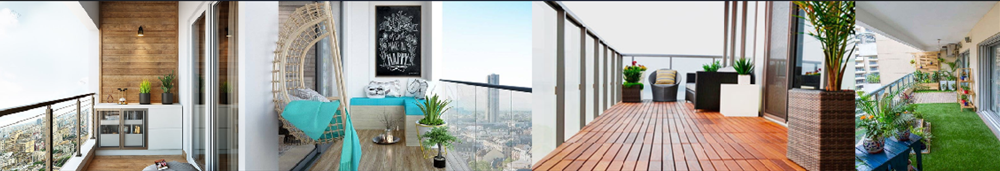
+ Distribution of Balcony across listings.
+ Most common Balcony Count among properties?
+ Is there any skew in distribution?

<br><br>

---
# **`N.` Distribution of Balcony across Property listings.**

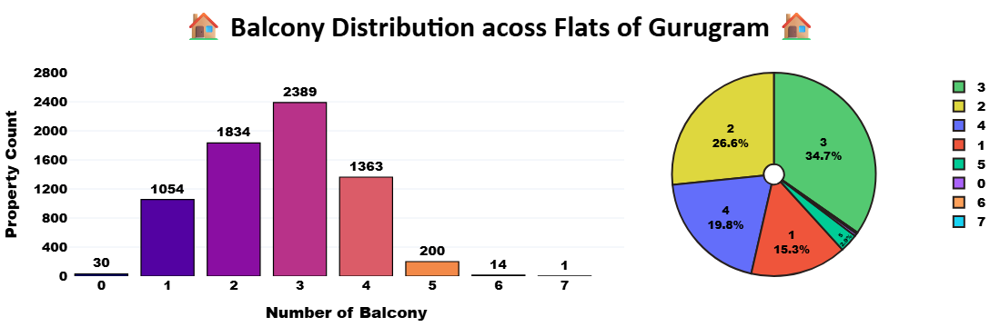

In [7]:
def Distribution_of_Balcony():
    ## Preparing data for Analysis:
    data = df[df['Balcony'] != '-']
    data['Balcony'] = data['Balcony'].replace({'No Balcony': '0'}).astype('int32')
    count_data = data["Balcony"].value_counts().reset_index()
    count_data.columns = ["Number of Balcony", "Property Count"]
    
    ## ----------------------------------------------------------------------------------------------------
    ## Create Plotly Subplot layout (1 row, 2 columns)
    fig = make_subplots(rows=1, cols=2, specs=[[{"type": "bar"}, {"type": "pie"}]], 
                        column_widths = [0.65, 0.35], horizontal_spacing=0)
    
    ## Creating 2 Plots - Plotly Express Bar Chart:
    bar_fig = px.bar(count_data, x="Number of Balcony", y="Property Count",
                text="Property Count",                      # Show counts as labels
                color="Number of Balcony",                  # Different color per category
                color_discrete_sequence=px.colors.qualitative.Pastel,  # Custom color palette
    )
    
    ## Customizing Bar Chart:
    bar_fig.update_traces(textposition="outside",            # Move labels outside bars
                          marker=dict(line=dict(color="black", width=1.2)))
    
    ## Add bar traces from px.bar into subplot:
    for trace in bar_fig.data:
        fig.add_trace(trace, row=1, col=1)
    
    ## Adding a Pie chart: ---------------------------------------------------------------------------------
    trace = go.Pie(labels=count_data["Number of Balcony"], values=count_data["Property Count"],
                   direction='counterclockwise', textinfo='label+percent',
                   marker=dict(colors=['#54C971', '#DED73E'],  # Custom colors
                              line=dict(color='#261F1D', width=2)  # Border color and width
                             ), hole=0.1,
                  textfont=dict(family='Arial Black', color='black', size=12), textposition='inside',
                  hovertemplate="Number of Balcony: %{label}<br>Tot. Percent: %{percent}<extra></extra>")
    
    fig.add_trace(trace, row=1, col=2)
    
    fig.update_yaxes(range=[0, 2801], tick0 = 0, dtick=400, row=1, col=1)
    fig.update_xaxes(range=[-0.5, 7.9], tick0 = 0, dtick=1, row=1, col=1)
    
    fig.update_layout(
        xaxis_title="Number of Balcony",
        yaxis_title="Property Count",
        yaxis=dict(showgrid=True, zeroline=False),
        plot_bgcolor="rgba(0,0,0,0)",      # Transparent background
        font=dict(size=14, family = 'Arial Black', color = 'black'),
        template="plotly_white",
        height=420, margin=dict(l=50, r=50, t=80, b=10),
        title=dict(text="<b>🏠 Balcony Distribution acoss Flats of Gurugram 🏠</b>", x=0.5, 
                   font=dict(size=32, color="black", family="Calibri"), automargin=False),
        coloraxis_showscale=False,  # Hides treemap colorbar if present
    )
    
    fig.show(config=dict(displaylogo=False,
        modeBarButtonsToRemove=["pan2d", "zoom2d","select2d","lasso2d","zoomIn2d","zoomOut2d","autoScale2d",
                                "resetScale2d","toImage"]))

Distribution_of_Balcony()

### **`🔍 OBSERVATIONS :`**
* **Majority of flats** have **2 to 3 balconies**, with **3 balconies (34.7%)** being the **single largest category** (~2389 flats).
* **2 balconies** are **also common**, covering **26.6% (~1834 flats)**.
* **4 balconies** form **another significant share** at **19.8% (~1363 flats)**.
* **Smaller proportions** exist for **1 balcony (15.3%, 1054 flats)**.
* **Very few flats** have **5 or more balconies** (only ~215 flats combined).
* **Negligible cases** exist for **0 balcony (30 flats)** and **7 balconies (just 1 flat)**.


### **`💡 Interpretation`**
* The **distribution shows** that **balcony availability is a standard feature** in Gurugram flats.
* **3 balconies is the most preferred design**, *likely aligning with popular 3BHK layouts* where each room is connected to a balcony.
* Flats with **higher number of balconies (4–5)** are **probably luxury units** or **larger configurations** (4BHK+).
* **0 balcony and extreme counts (6–7)** are outliers and **not representative of market norms**.


### **`🎯 Implication for Stakeholders`**
* **Buyers**: Can expect **2–3 balconies in most flats**, ensuring ventilation and usable outdoor space.
* **Builders/Developers**: Standardizing **3 balconies** caters to **majority demand**, while offering **4+ balconies** can be **positioned as** a **luxury feature**.
* **Investors**: Properties with **3 or more balconies** may hold better **resale/rental appeal**, especially **for families valuing space and openness**.

---

### **`✅ CONCLUSION :`**
Balcony distribution in Gurugram flats is **highly concentrated around 2–3 balconies**, making it the **functional standard**. **Larger flats (4BHK+) add more balconies**, while **outliers (0, 6, 7) are rare and not significant** in the overall market. For stakeholders, **3 balconies serve as the sweet spot** for both demand and design alignment.

<br><br>

---
# **`O.` Distribution of Balcony across 5 Major Flat Types.**
- Does particular number of Balconies associated with a particular BHK type?
- Does higher BHKs have unnecessarily high number of balconies?

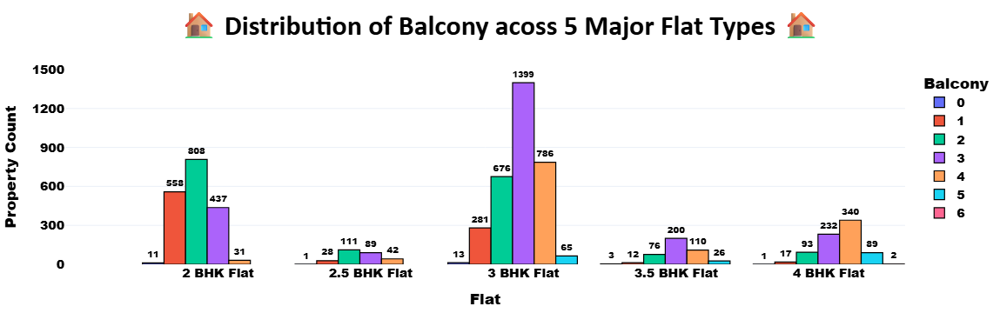

In [25]:
def Distribution_of_Balcony_across_5_Major_Flat_Types():
    ## Preparing data for Analysis:
    five_maj_flats = sorted(df['Flat'].value_counts().head(5).index)
    data = df[(df['Balcony'] != '-') & df['Flat'].isin(five_maj_flats)]
    data['Balcony'] = data['Balcony'].replace({'No Balcony': '0'}).astype('int32')
    
    ## Plotting a grouped Count Plot: ----------------------------------------------------------------
    fig = px.histogram(data, x="Flat",       # category to count
                       color="Balcony",       # for further categorisation of 'x'
                       barmode="group",           # bar options: "group", "overlay", "stack"
                       text_auto=True,             # show counts on bars
                       category_orders={'Balcony':[0,1,2,3,4,5,6],   # for ordering the x labels and legends
                                       'Flat':five_maj_flats}           )
    
    ## Customizing the Count Plot:
    fig.update_traces(textposition="outside",            # Move labels outside bars
                      marker=dict(line=dict(color="black", width=1.2)),  # Border around bars
                      textfont=dict(family='Arial Black', color='black', size=10),
                      hovertemplate="Flat: %{x}<br>Property Count: %{y}<extra></extra>"           )
    
    fig.update_yaxes(range=[0, 1500], tick0 = 0, dtick=300)
    fig.update_xaxes(range=[-1, 4.5], tick0 = 0, dtick=1)
    
    fig.update_layout(
        xaxis_title="Flat",
        yaxis_title="Property Count",
        yaxis=dict(showgrid=True, zeroline=False),
        bargap=0.01,
        plot_bgcolor="rgba(0,0,0,0)",      # Transparent background
        font=dict(size=14, family = 'Arial Black', color = 'black'),
        
        template="plotly_white",
        height=420, margin=dict(l=50, r=50, t=80, b=10),
        title=dict(text="<b>🏠 Distribution of Balcony acoss 5 Major Flat Types 🏠</b>", x=0.5, 
                   font=dict(size=32, color="black", family="Calibri"), automargin=False)         )
    
    fig.show(config=dict(displaylogo=False,
        modeBarButtonsToRemove=["pan2d", "zoom2d","select2d","lasso2d","zoomIn2d","zoomOut2d","autoScale2d",
                                "resetScale2d","toImage"]))

Distribution_of_Balcony_across_5_Major_Flat_Types()

### **`🔍 OBSERVATIONS :`**
* **2 BHK flats**: **Mostly** come with **2 balconies (808 flats)**, followed by **1 balcony (558)** and **3 balconies (437)**.
* **2.5 BHK flats**: **Largely** distributed across **2 balconies (111)** and **3 balconies (89)**, with some having **4 balconies (42)**.
* **3 BHK flats**: **Strongly concentrated** in **3 balconies (1399 flats)**, followed by **4 balconies (786)** and **2 balconies (676)**.
* **3.5 BHK flats**: **Typically** have **3 balconies (200 flats)** or **4 balconies (110)**, with a few extending to **5 balconies (26)**.
* **4 BHK flats**: **Skewed** towards **4 balconies (340 flats)**, followed by **3 balconies (232)** and **5 balconies (89)**.
* **Extreme cases** with **0, 1, or 6 balconies** exist **but are RARE**.


### **`💡 Interpretation`**
* A **clear alignment** exists **between BHK type and balcony count**:
  * **2 BHK → 2 balconies standard**.
  * **3 BHK → 3 balconies standard**.
  * **4 BHK → 4 balconies standard**.
* **Balcony count increases with flat size**, suggesting a **functional correlation between bedroom count and outdoor access**.
* **Higher BHKs occasionally** show **extra balconies (5–6)**, which may **reflect luxury or premium design choices** rather ***than practical necessity***.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers**: Can *expect balcony numbers to scale with flat size* (e.g., 2 BHK with 2 balconies, 3 BHK with 3). This **helps in setting realistic expectations** when shortlisting.
* **Builders/Developers**: Reinforces the **design standard** of linking balconies with BHK count, but **offering extra balconies in larger flats** can **act as** a **luxury differentiator**.
* **Investors**: Properties with **standardized balcony configurations** (2–3 for 2–3 BHKs) will likely appeal to the mass market, while higher balcony counts in **4 BHK+** can be marketed to niche luxury buyers.

---

### **`✅ CONCLUSION :`**
**`Balcony distribution strongly aligns with flat type`**: **2 BHK → 2 balconies, 3 BHK → 3 balconies, 4 BHK → 4 balconies** as the **dominant trend**. **Extra balconies in higher BHKs exist but are limited** and **represent luxury design** ***rather than necessity***. This reflects a balance between functional design and aspirational features in Gurugram flats.

---

#### **`❓ Quick Questions to Answer :`**
#### **Does particular number of balconies associate with a particular BHK type?**
✅ **YES**, strong association: **2 BHK → 2 balconies, 3 BHK → 3 balconies, 4 BHK → 4 balconies**.
#### **Do higher BHKs have unnecessarily high number of balconies?**
⚠️ ***Sometimes yes*** — **4 BHK flats with 5–6 balconies** exist but are **rare and more of a luxury feature** *than a necessity*.

<br><br>

---
# **`P.` How does the Number of Balconies affect Property Pricing?**

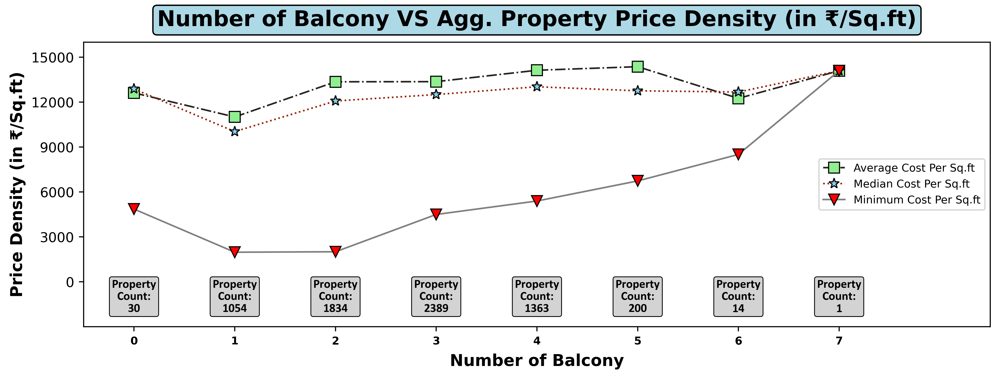

In [49]:
## Preparing data for analysis:
data = df[df['Balcony'] != '-']
data['Balcony'] = data['Balcony'].replace({'No Balcony': '0'}).astype('int32')

## Grouping data based on "Number of Balcony" and finding mean and median "Property Price Per Sqft" 
## for each of the group:
def func_price(data):
    pro_pri = data['Avg_price_rupee_per_sqft']
    return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
         index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                            ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))

data = data.groupby(by = 'Balcony').apply(func_price).astype({('Price', 'tot_prop_listed'):'int32'})
data = data.reset_index()

## ------------------------------------------------------------------------------------------------
## Creating Plot: 
fig = plt.figure(figsize = (12,3.8), dpi = 500)
ax = fig.add_subplot(1,1,1)
bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}

ax.plot(data['Balcony'].astype(str), data[('Price', 'mean')], linewidth=1.2, color='#292422', 
        linestyle='-.', label = 'Average Cost Per Sq.ft', marker = 's', markersize  = 8,  
        markerfacecolor='lightgreen', markeredgecolor='black', markeredgewidth = 0.8)

ax.plot(data['Balcony'].astype(str), data[('Price', 'median')], color='#96210C', linestyle=':',
        linewidth=1.2, label = 'Median Cost Per Sq.ft', marker = '*', markersize  = 8, 
        markerfacecolor='skyblue',markeredgecolor='black', markeredgewidth = 0.8)

ax.plot(data['Balcony'].astype(str), data[('Price', 'min')], linewidth=1.2, color='grey', 
        linestyle='solid', label = 'Minimum Cost Per Sq.ft', marker = 'v', markersize  = 8,  
        markerfacecolor='red', markeredgecolor='black', markeredgewidth = 0.8)

ax.set_title('Number of Balcony VS Agg. Property Price Density (in ₹/Sq.ft)', 
             fontsize=16, fontweight='bold', bbox = bbox, pad = 12)
ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=12, fontweight='bold')
ax.set_xlabel('Number of Balcony', fontsize=12, fontweight='bold', labelpad = 5)

ax.set_xlim(-0.5, 8.5)
ax.set_xticks(list(range(0, 8)))
ax.set_xticklabels(data['Balcony'].astype(str), fontsize = 8, fontweight = 'bold')

ax.set_ylim(-3000,16000)
ax.set_yticks(list(range(0, 16001, 3000)))

## Annotate Property Count:
for prop_count, num_bal in zip(data[('Price', 'tot_prop_listed')], sorted(data['Balcony'].unique())):
    ax.text(num_bal, -1000, f"Property\nCount:\n{prop_count}", ha='center', va='center', fontsize=9, 
            fontweight='bold', fontfamily='Calibri', color='black', 
            bbox={'facecolor': 'lightgrey', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                  'linewidth': 0.6} )

ax.legend(fontsize=8, loc = 'center right')

plt.show()

### **`🔍 OBSERVATIONS :`**
* **Property concentration**: Majority of flats have **2 (1834)**, **3 (2389)**, or **4 (1363)** balconies, making them the **most common configurations**.
* **`Average & Median Price Densities :`**
  * Stay **fairly stable** around **₹12,000–₹14,000 per sq.ft** for **flats with 2–5 balconies**.
  * Slight **dip at 1 balcony** ~₹10,500 per sq.ft) suggesting **lower demand/value**.
  * **Peak values at 5 balconies ~₹14,000+ per sq.ft)**, though **sample size is smaller (200 flats)**.
* **Minimum Price Density**: Shows a **U-shaped trend**—very low for 1–2 balconies, but **rises significantly after 3 balconies**, reaching very high levels for 6–7 balconies (though counts are negligible).
* **OUTLIERS**: Flats with **6 (14 flats) or 7 (1 flat) balconies** show **very high aggregated price densities**, but the ***sample is too small for reliable insights***.


### **`💡 Interpretation`**
* A **standard balcony-to-flat relationship** exists, with **most properties falling into the 2–4 balcony range**.
* **Higher balcony counts (5–7)** may **signal premium/luxury flats**, but their **rarity makes them less representative of market norms**.
* **Median and average densities** suggest that **adding more than 4 balconies DOES NOT drastically improve per sq.ft. value**, except in niche luxury categories.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers**:
    - Flats with **2–4 balconies** are the **most common** and **price-stable**, offering predictable value.
    - **Extra balconies** (5+) should be **considered only if** they **enhance utility/luxury** rather than being swayed by inflated pricing.
* **Developers**:
    - **Demand** is concentrated **around 2–4 balconies**, which should **remain the design norm**.
    - Offering **5+ balconies** may serve as a **luxury niche product** but **not mass-market**.
* **Investors**:
    - Focus on **2–3 balcony properties** for steady resale value and liquidity, as **they dominate supply and demand**.

---

### **`✅ CONCLUSION :`**
**Balcony count correlates with property density** in a **balanced way for 2–4 balconies**, where most flats cluster and price densities are stable. **While 5+ balconies do push properties into higher price bands**, these are **rare** and largely represent **luxury positioning rather than practical necessity**. The **mainstream market aligns** strongly with **2–4 balcony homes**.
<br><br>

---
---

<br><br>

<br>
<br>

# **`V. 🏘️ Society Insights`**

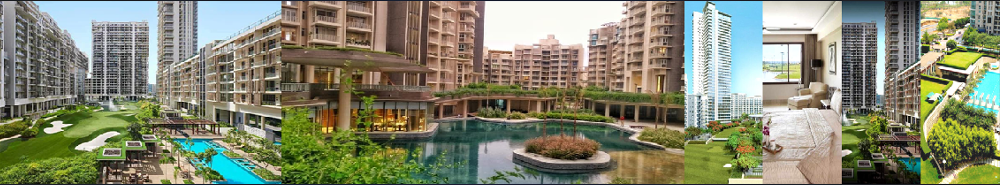

### **`Societies of Gurugram — Key Insights`**
* Gurugram has a very **diverse society/residential-project ecosystem**: ranging from **ultra-premium gated luxury projects** to **mid-market housing** and **emerging societies** in newly developed sectors.
* Some of the most **posh / high-end societies** are M3M Golf Estate (Sector 65), DLF The Camellias (Golf Course Road), SS Hibiscus (Sector 50), Ireo The Corridors (Sector 67A), Tata Raisina Residency (Sector 59). These **tend to offer resort-style amenities**, **large flats**, **large green/open spaces**, **luxury finishes**, proximity to **premium infrastructure**.<br><br>
* There’s also **strong presence of “affordable / mid-market societies”** especially in ***New Gurgaon sectors (e.g. Sector-82, 107, etc.)*** and along expressway connectivity corridors, where **projects offer good amenities but more moderate ₹/sq.ft prices**. Our data also confirms many societies in that mid-price band.
* **Landmarks or premium branding** (e.g. “Golf Course Road”, “Aravalli views”, developers with reputation) **play a big role** in **pushing societies into higher price density categories**.
    + **Projects with newer infrastructure** (good road, metro access, amenities) tend to **command a premium**.<br><br>
* **New launches / emerging societies** are increasingly **integrating features** like gated layouts, wellness spaces, smart amenities, open green areas — matching preferences we see in our data (higher ₹/sq.ft societies often have more amenities + higher furnishing etc.).
* **`According to Recent News:`** the **DLF Camellias** society is **among** the **top luxury addresses**; for example, a **very large apartment** there was **sold for** over **₹52 crore** (10,813 sq ft) recently. That **shows the scale of high-end deals**.

<br><br>

---
# **`A.` Societies of Gurugram.**

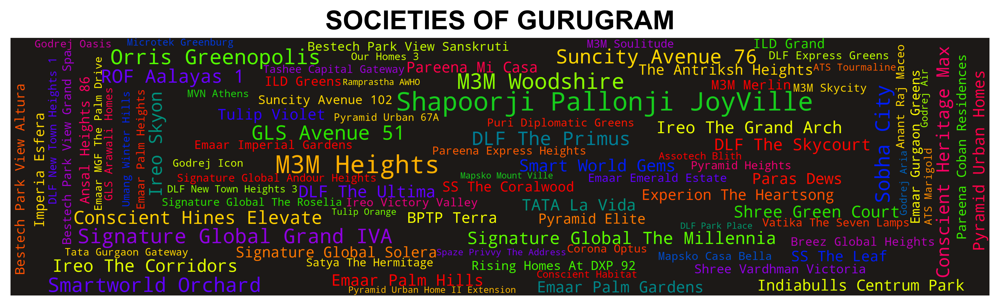

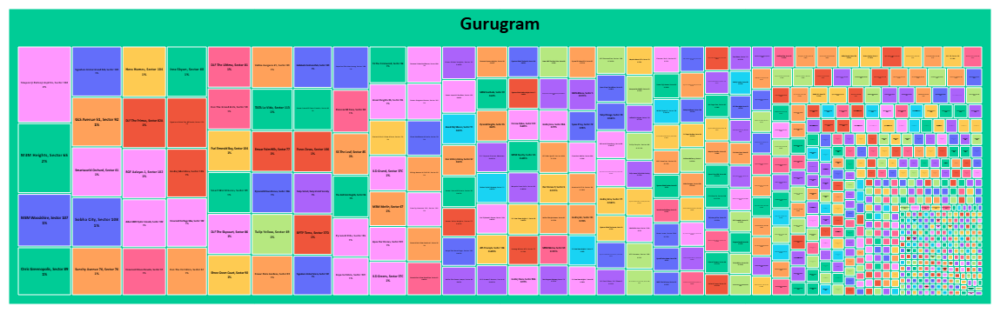

In [179]:
def Society_Distribution():
    ## Preparing data for analysis:
    data = df[df['Society'] != '-']
    
    data = data.groupby(by=['Society', 'Address']).apply(lambda x: pd.concat([x[['Society', 'Sector',
                                                                          'Address']].iloc[0], 
                                                                      pd.Series([x.shape[0]], 
                                                                                index=['Prop_count'])]))
    data = data.reset_index(drop = True)
    
    ## Creating Word Cloud of Societies: -----------------------------------------------------------------
    fig = plt.figure(figsize = (12, 4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    
    wc = WordCloud(width=3800, height=1000, background_color="#1C1917",
                   colormap="prism",             # color palette
                   contour_color="black",          # outline color
                   contour_width=12,                # outline thickness
                   max_words=1000,                  # limit words
                   max_font_size=100,               # largest word size
                   min_font_size=30,               # smallest word size
                   prefer_horizontal=0.75,          # orientation of words
                   random_state=32 )
    
    wc.generate_from_frequencies(data.set_index("Society")["Prop_count"].to_dict())
    
    ax.imshow(wc, interpolation="bilinear")
    ax.axis("off")
    ax.set_title('SOCIETIES OF GURUGRAM', fontsize=18, fontweight='bold', color='black', 
                 fontfamily='Arial')
    
    plt.show()
    
    ## Creating a TreeMap: -------------------------------------------------------------------------------
    
    ## Label for treemaps:
    labels = data.apply(lambda x: x['Society'] + ", " + x['Sector'] if x['Sector'] != '-' 
                        else x['Society'] + ", " + x['Address'][len(x['Society']) + 2 : -9], axis=1)
    
    data.insert(2, 'Label', labels)
    
    fig = px.treemap(data, path=[px.Constant('Gurugram'),'Label'], 
                     values = 'Prop_count',
                     color = 'Sector' , color_continuous_scale='Viridis'  )
    
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=10, b=10),
                      paper_bgcolor='white')
    
    fig.update_traces(textinfo="label+percent parent",
                      hovertemplate='<b>%{label}</b><br>Property Count: %{value}<br>City: %{parent}<extra></extra>',
                      textfont=dict(size=22, color="black", family="Calibri black"),
                      textposition="middle center",
                      tiling=dict(pad=2) )
    
    fig.show()

Society_Distribution()

In [211]:
## Stats related to Societies:
print("\t\t\t\t\t\tSOCIETY STATS")
print("\t\t\t\t\t\t-------------")

print('Total number of unique Societies offering Flats in Gurugram are :', data.shape[0], '\n')

print('5 Societies offering most number of Properties are :')
for i in data.sort_values(by='Prop_count', ascending=False)['Society'].iloc[0:5].values:
    print('\t\t\t\t\t\t   ',i)

print('\nNumber of Societies offering less than 10 Flats are : ', data[data['Prop_count']<=10].shape[0])
print('Number of Societies offering less than 20 Flats are : ', data[data['Prop_count']<=20].shape[0])
print('Number of Societies offering more than 30 Flats are : ', data[data['Prop_count']>=30].shape[0])


print('\nAverage Property Listings across Societies : ', round(data['Prop_count'].mean(), 3))
print('Median Property Listings across Societies : ', round(data['Prop_count'].median(), 3))
print('Minimum Property Listings across Societies : ', data['Prop_count'].min())
print('Maximum Property Listings across Societies : ', data['Prop_count'].max())

						SOCIETY STATS
						-------------
Total number of unique Societies offering Flats in Gurugram are : 672 

5 Societies offering most number of Properties are :
						    Shapoorji Pallonji JoyVille
						    M3M Heights
						    M3M Woodshire
						    Orris Greenopolis
						    Signature Global Grand IVA

Number of Societies offering less than 10 Flats are :  491
Number of Societies offering less than 20 Flats are :  560
Number of Societies offering more than 30 Flats are :  62

Average Property Listings across Societies :  9.93
Median Property Listings across Societies :  3.0
Minimum Property Listings across Societies :  1
Maximum Property Listings across Societies :  115


### **`🔍 OBSERVATIONS :`**
* **Larger text size** indicates **higher property listings** in those societies.
* Societies like **M3M Heights, Shapoorji Pallonji Joyville, Orris Greenopolis, GLS Avenue 51, Signature Global Grand IVA, Conscient Hines Elevate, and Smartworld Orchard** ***dominate*** the word cloud, suggesting they **have the most listings**.
* **Mid-sized societies** include **DLF The Ultima, Ireo The Corridors, M3M Woodshire, Tulip Violet, Sobha City, Paras Dews, ROF Aalayas 1, and Suncity Avenue 76**.
* **Smaller-sized names** indicate societies with **relatively fewer listings**, scattered across the cloud.


### **`💡 Interpretation`**
* The **distribution is SKEWED**, with a **handful of societies** (like M3M Heights & Joyville) **contributing** a **bulk of the property listings**.
* **Popular developers** such as **M3M, DLF, Signature Global, Emaar, Ireo, and Shapoorji Pallonji** have **multiple societies** appearing prominently, reflecting **brand dominance in Gurugram’s property market**.
* **Societies** with **smaller presence** may be either **newly developed, niche luxury projects, or less in-demand areas**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers**: **Larger societies** (big fonts) offer **more variety and options**, better for price comparisons. **Smaller ones may cater** to **niche buyers**.
* **Developers/Investors**: **Strong demand** is concentrated around **big societies and reputed developers**, making them **safer bets for sales and appreciation**.
* **Brokers/Agents**: Can **prioritize marketing and lead generation** efforts in **top-listed societies** to maximize conversion opportunities.

---

### **`✅ CONCLUSION :`**
The word cloud reveals that Gurugram’s property market is **dominated by a few high-listing societies and renowned developers**, while **several smaller societies exist with niche presence**. This imbalance indicates a **consolidated demand pattern**, where buyers and sellers focus on **well-known projects with higher visibility and credibility**.

<br><br>

---
# **`B.` Which are the Most Expensive Societies and which are Economical among the Top 20 based on number of listings?**

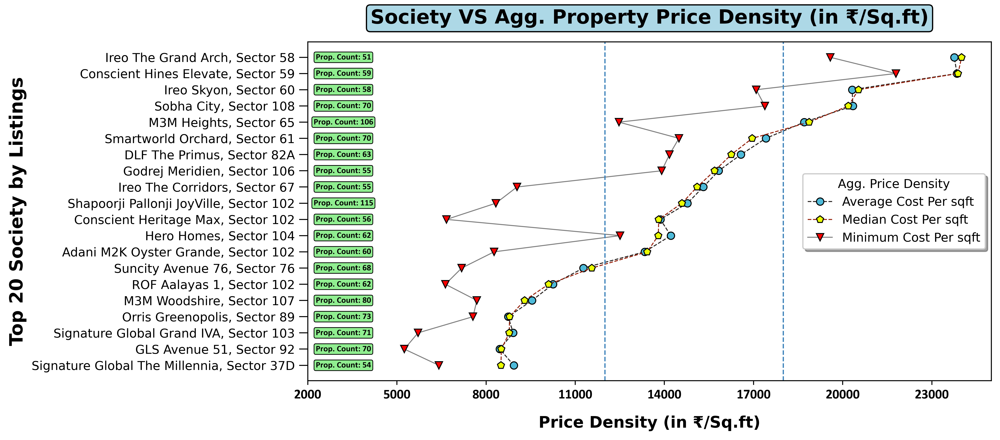

In [238]:
## Preparing data for analysis:
data = df[df['Society'] != '-']

## Creating list of top 30 Societies by number of listings:
top_20_soc = data.groupby(by=['Society', 
                              'Address']).apply(lambda x: pd.concat([x[['Society','Address']].iloc[0],
                                                                     pd.Series([x.shape[0]],
                                                                               index=['Prop_count'])]))

top_20_soc = top_20_soc.sort_values(by='Prop_count', ascending=False).reset_index(drop=True).head(20)
top_20_soc_list = (top_20_soc['Society'] + ", " + top_20_soc['Address']).tolist()

## Filtering DF based on created list:
data['Soc_Filter'] = data['Society'] + ", " + data['Address']
data = data[data['Soc_Filter'].isin(top_20_soc_list)]

## Grouping data based on "Socities" and finding mean and median "Property Price Per Sqft" 
## for each of the group:
def func_price(data):
    pro_pri = data['Avg_price_rupee_per_sqft']
    agg_price =  pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), 
                            pro_pri.median()],
         index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                            ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))

    soc_info = pd.Series([data['Society'].iloc[0], data['Sector'].iloc[0], data['Address'].iloc[0]],
                        index=['Society', 'Sector', 'Address'])

    return pd.concat([soc_info, agg_price])

data = data.groupby(by = 'Soc_Filter').apply(func_price).astype({('Price','tot_prop_listed'):'int32'})
data = data.reset_index(drop=True).sort_values(by=('Price', 'median'))

## ------------------------------------------------------------------------------------------------
## Creating Plot: 
fig = plt.figure(figsize = (10,5), dpi = 500)
ax = fig.add_subplot(1,1,1)
bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}

ax.plot(data[('Price', 'mean')], data['Society'] + ', ' + data['Sector'], linewidth=0.8, color='#292422', 
        linestyle='--', label = 'Average Cost Per sqft', marker = 'o', markersize  = 6,  
        markerfacecolor='#4EBAD9', markeredgecolor='black', markeredgewidth = 0.8)

ax.plot(data[('Price', 'median')], data['Society'] + ', ' + data['Sector'], color='#96210C', linestyle='--',
        linewidth=0.8, label = 'Median Cost Per sqft', marker = 'p', markersize  = 6, 
        markerfacecolor='#EAFF00',markeredgecolor='black', markeredgewidth = 0.8)

ax.plot(data[('Price', 'min')], data['Society'] + ', ' + data['Sector'], linewidth=0.8, color='grey', 
        linestyle='solid', label = 'Minimum Cost Per sqft', marker = 'v', markersize  = 6,  
        markerfacecolor='#FF0000', markeredgecolor='black', markeredgewidth = 0.8)

ax.axvline(12000, color='#3C82BA', linestyle='--', linewidth=1)
ax.axvline(18000, color='#3C82BA', linestyle='--', linewidth=1)

ax.set_title('Society VS Agg. Property Price Density (in ₹/Sq.ft)', 
             fontsize=16, fontweight='bold', bbox = bbox, pad = 15)
ax.set_ylabel('Top 20 Society by Listings', fontsize=15, fontweight='bold')
ax.set_xlabel('Price Density (in ₹/Sq.ft)', fontsize=13, fontweight='bold', labelpad = 12)

ax.set_xlim(2000, 25000)
ax.set_xticks(list(range(2000, 25000, 3000)))
ax.set_xticklabels(list(range(2000, 25000, 3000)), fontsize = 11, fontweight = 'bold',
                  fontfamily='Calibri')

ax.tick_params(axis='y', size=7)

## Annotate Property Count:
lis_socities = (data['Society'] + ', ' + data['Sector']).tolist()

for prop_count, society in zip(data[('Price', 'tot_prop_listed')].values, range(len(lis_socities))):
    ax.text(3200, society, f"Prop. Count: {prop_count}", ha='center', va='center', fontsize=7, 
            fontweight='bold', fontfamily='Calibri', color='black', 
            bbox={'facecolor': 'lightgreen', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                  'linewidth': 0.6} )

ax.legend(fontsize=8, loc = 'right', title='Agg. Price Density', prop={'size': 10}, frameon=True, 
          fancybox=True, framealpha=1, shadow=True)

plt.show()

### **`🔍 OBSERVATIONS :`**
* The chart plots **top 20 societies of Gurugram** by property listings against **aggregated property price density (₹/Sq.ft)**.
* **Median and Average Price Densities** are **closely aligned**, showing **stable pricing patterns** across most societies.
* **Minimum Price Density** ***varies significantly***, with some societies offering **low-cost outliers despite** overall **higher averages**.
* **Societies positioned at** the **higher end** (> ₹18,000/Sq.ft) like:
    + **Ireo The Grand Arch**,
    + **Conscient Hines Elevate**,
    + **Ireo Skyon**, and
    + **Sobha City**.
* **Societies falling into** the **lower segment (< ₹12,000/Sq.ft)** such as:
    + **ROF Aalayas 1**,
    + **Signature Global Grand IVA**,
    + **GLS Avenue 51** and
    + **Signature Global The Millennia** .
* A **majority of societies** cluster **in** the **₹12,000–18,000/Sq.ft range**, showing a **concentration of mid-market offerings**.


### **`💡 Interpretation`**
* The **Gurugram housing market** looks **tiered into three broad price segments**:
  1. **Luxury** (> ₹18,000/sq.ft) — developer-driven **gated communities with premium amenities**.
  2. **Mid-range/Affordable Mass Segment** (₹12,000–18,000/sq.ft) — *majority of listings*, **catering to upper middle-class demand**.
  3. **Budget Entry** (< ₹12,000/sq.ft) — value housing options, **attracting cost-conscious buyers**.
* **Significant spread** in **minimum prices** *within societies* suggests **diverse unit types** or **older resale listings co-existing with new premium units**.


### **`🎯 Implication for Stakeholders`**
* **Buyers**: Can align choices with their affordability; luxury buyers may focus on premium societies, while **mid-range has** the **widest pool of options**.
* **Developers**: Opportunity exists to **consolidate supply in the ₹12,000–18,000/sq.ft band**, which has the **maximum absorption potential**.
* **Investors**: Premium societies (> ₹18,000/sq.ft) hold **long-term appreciation** potential, while mid-range is best for **steady rental yields**.
* **Policy Makers**: Should **encourage balanced development** across categories to avoid **price saturation in mid-market**.

---

### **`✅ CONCLUSION :`**
The **Gurugram real estate market**, as seen from the top 20 societies, **exhibits** a **clear three-tier segmentation**. **Most properties lie in** the **₹12,000–18,000/sq.ft affordable–mid bracket**, making it the **demand hotspot**. However, **luxury clusters** sustain strong pricing power, while a **small portion** of societies cater to **entry-level affordability (< ₹12,000/sq.ft)**. This mix reflects Gurugram’s positioning as both a **luxury hub and a mass-market residential zone**.

---
---

<br><br>

<br><br>

# **`VI. 💸 EMI :`**

## **💰 Key Insights on EMIs in Gurgaon**
* **Current home loan interest rates** in India (and hence in Gurgaon) are roughly **7.3% to about 9-10% per annum** depending on *bank, borrower profile, down payment* etc.
* Banks like **SBI** are **offering home loans starting** from **~7.50% p.a.**.
* In Gurgaon, **fintech / lender platforms report home-loan interest rates** in the range **8.35% to ~ 10-11%** for *different types of borrowers or properties*.
* A **recent repo rate cut by the RBI** (3rd quarter 2025) has **led to some rate drops being passed down**, helping lower EMI burden. For example, for a ₹1 crore loan over 20 years, a 50 bps rate cut can reduce the EMI by a few thousand rupees per month.


## **💡 Key Implications :**
* Even **small differences in interest rate** (say 0.5-1%) **lead** to **significant EMI savings** over long tenures **on big loan amounts** (7-10+ years).
* **High-end properties** (3-4 BHK etc.) with **higher loan amounts magnify** the **burden of EMIs**, making interest rate negotiation / selection more important for buyers.
* **As interest rates have eased a bit**, **buyers** considering entering the market **now find slightly improved affordability vs earlier periods**.

<br><br>

---
# **`A.` Distribution of EMI for 5 Major Flat Types ?**

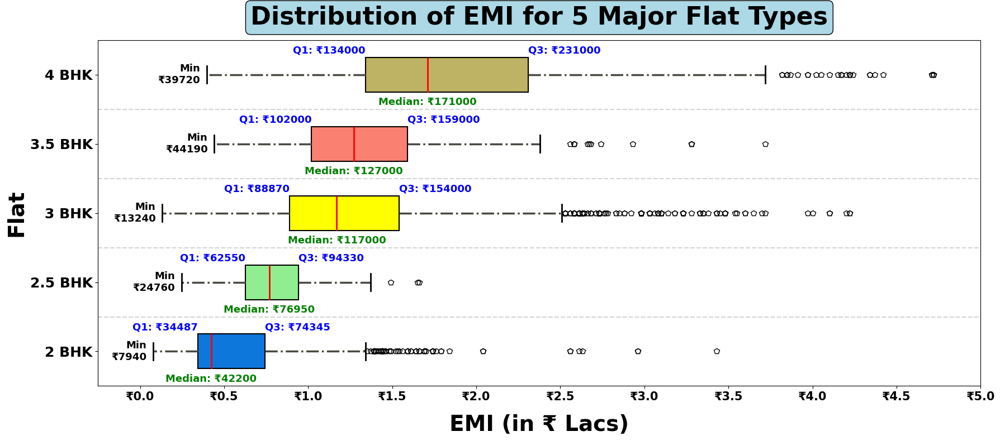

In [346]:
## Preparing data for analysis:
data = []
flat_types = sorted(df['Flat'].value_counts().head(5).index)
for i in flat_types:
    data.append(df[(df['Flat'] == i) & (df['EMI_in_rupees'] <= 480000)]['EMI_in_rupees'].values)

## Creating plot: -----------------------------------------------------------------------------------
fig = plt.figure(figsize = (18,8))
ax = fig.add_subplot(1,1,1)
bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}

box = ax.boxplot(data, vert = False, patch_artist=True)

colors = ['#0D77DB', 'lightgreen', 'yellow','salmon', '#BEB264']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    patch.set_edgecolor('black')
    patch.set_linewidth(1.5)

# Customize median lines
for median in box['medians']:
    median.set_color('red')
    median.set_linewidth(2)

# Customize whiskers
for whisker in box['whiskers']:
    whisker.set_linestyle('-.')
    whisker.set_color('#4A4840')
    whisker.set_linewidth(2.5)
    
# Customize caps
for cap in box['caps']:
    cap.set_color('black')
    cap.set_linewidth(2)
    
# Customize fliers (outliers)
for flier in box['fliers']:
    flier.set(marker='p', color='orange', markersize=7)

# Annotate quantiles
annot_info = []
for i in range(len(data)):
    q1 = np.percentile(data[i], 25)
    q2 = np.percentile(data[i], 50)  # median
    q3 = np.percentile(data[i], 75)
    qmin = np.min(data[i])
    annot_info.append(tuple([i+1, q1, q2, q3, qmin]))

for i, q1, q2, q3, qmin in annot_info:
    ax.text(qmin - 4000, i, f'Min\n₹{int(qmin)}', va='center', ha='right', color='black', fontweight='bold',
           fontsize=13)
    ax.text(q1, i + 0.35, f'Q1: ₹{int(q1)}', va='center', ha='right', color='blue', fontweight='bold',
           fontsize=13)
    ax.text(q2, i - 0.4, f'Median: ₹{int(q2)}', va='center', ha='center', color='green', fontweight='bold',
           fontsize=13)
    ax.text(q3, i + 0.35, f'Q3: ₹{int(q3)}', va='center', ha='left', color='blue', fontweight='bold',
           fontsize=13)
    plt.axhline(i + 0.5 , c='lightgrey', linestyle = '--')

# Customize with Matplotlib
ax.set_title("Distribution of EMI for 5 Major Flat Types", fontsize=32, fontweight='bold',
             bbox=bbox, pad=20)
ax.set_xlabel("EMI (in ₹ Lacs)", fontsize=28, fontweight='bold', labelpad=15)
ax.set_ylabel("Flat", fontsize=28, fontweight='bold')

#ax.set_facecolor('#f9f9f9')  # Background of plotting area
ax.set_yticks(list(range(1,len(flat_types)+1)))
ax.set_yticklabels([i[:-5] for i in flat_types] , fontsize=18,  fontweight='bold')

ax.set_xlim(-25000, 500001)
ax.set_xticks(list(np.arange(0,500001, 50000)))
ax.set_xticklabels(["₹" + str(round(i/ 1e5, 2)) for i in list(np.arange(0,500001, 50000).astype('int64'))], 
                   fontsize=15,  fontweight='bold')

plt.tight_layout()
plt.show()

### **`🔍 OBSERVATIONS :`**
* **2 BHK**: **Median EMI** is around **₹42K**, with Q1 ~₹34K and Q3 ~₹74K. **EMI values are relatively compact** but with a **long tail of outliers** extending **up to ~₹4.5 Lacs**.
* **2.5 BHK**: **Median EMI** is **higher** at **₹76K**, with Q1 ~₹62K and Q3 ~₹94K. **Spread is wider and uniform** compared to 2 BHK, but **outliers are fewer**.
* **3 BHK**: **Median EMI** is **₹1.17 Lacs**, with Q1 ~₹88K and Q3 ~₹1.54 Lacs. **Many high-value outliers** extend significantly beyond ₹2.5 Lacs.
* **3.5 BHK**: Median EMI increases further to **₹1.27 Lacs**, IQR between ₹1.02 Lacs – ₹1.59 Lacs. Distribution has **fewer outliers** but **shows premium pricing**.
* **4 BHK**: Highest median EMI at **₹1.71 Lacs**, IQR from ₹1.34 Lacs to ₹2.31 Lacs. **Wide variability**, with **extreme outliers >₹4.5 Lacs**.


### **`💡 Interpretation`**
* **EMI distributions** scale **positively with flat size (BHK type)**, reflecting *direct correlation between property size and financing requirement*.
* The **variability in EMI** also **increases with higher BHKs**, indicating a **broader range of property categories within 3–4 BHKs (mid-luxury to ultra-luxury)**.
* **Outliers in 2 & 3 BHK** segments suggest **certain projects priced disproportionately higher despite smaller configurations** — *likely due to location or luxury branding*.


### **`🎯 Implication for Stakeholders`**
* **Buyers**:
    + **Can benchmark** their **affordability range**;
    + **2 BHK is entry-level**, while **3 BHK and above enter premium EMI ranges**.
* **Banks/Financiers**: Must **design flexible EMI schemes for higher BHK segments** where EMI variability and affordability gaps are larger.
* **Developers**: Should **recognize** the **sweet spot in 2.5–3 BHK range**, where median EMIs remain achievable for upper-middle-class buyers while still offering significant market volume.
* **Investors**: Luxury segments (3.5–4 BHK) show large variability, meaning selective investment in high-demand premium societies is key.

---

### **`✅ CONCLUSION :`**
The **EMI distribution** clearly **highlights** the ***progressive jump in affordability requirements*** from **2 BHK (~₹42K median) to 4 BHK (~₹1.71 Lacs median)**. While 2–2.5 BHK flats remain in the affordable–mid segment for most salaried households, 3–4 BHK flats fall into premium categories, with wide spreads **reflecting market heterogeneity**. Stakeholders must tailor financing, pricing, and product strategy according to these affordability bands.

---
#### **`❓ Quick Questions to Answer :`**
#### **Does EMI form a fixed percentage of Property Price?**
✅ **YES**, EMI is **directly derived** from **Property Price, loan amount, interest rate, and tenure**. *Since property price is the base, EMI is proportional to it*.

#### **Using EMI feature would lead to Data Leakage?**
✅ **YES**. Including **EMI as a feature in a predictive model** (e.g., predicting property price) **would cause *"Data Leakage"***, because EMI is mathematically dependent on property price and offers no independent information.

---
---
---

<br><br>

<br><br>

# **`VII. 🏗️ Sellers & Builders :`**

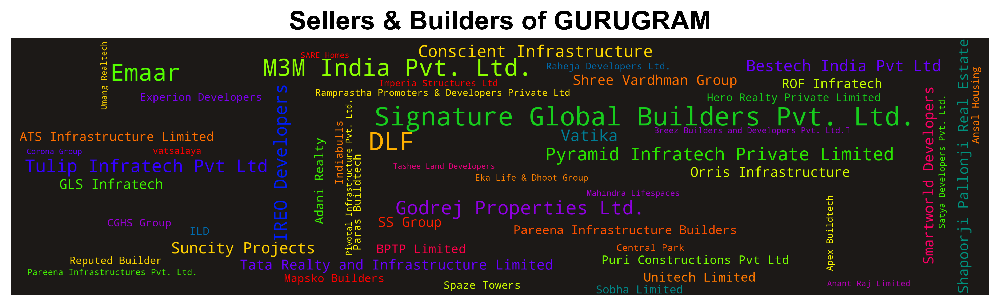

In [47]:
## Preparing data for analysis:
data = df[df['Seller_Builder'] != '-']

data = data.groupby(by=['Seller_Builder']).apply(lambda x: pd.Series([x.shape[0]], index=['Prop_count']))
data = data.reset_index(drop = False)

## Creating Word Cloud of Societies: -----------------------------------------------------------------
fig = plt.figure(figsize = (12, 4), dpi = 500)
ax = fig.add_subplot(1,1,1)

wc = WordCloud(width=3800, height=1000, background_color="#1C1917",
               colormap="prism",             # color palette
               contour_color="black",          # outline color
               contour_width=12,                # outline thickness
               max_words=1000,                  # limit words
               max_font_size=100,               # largest word size
               min_font_size=30,               # smallest word size
               prefer_horizontal=0.75,          # orientation of words
               random_state=32 )

wc.generate_from_frequencies(data.set_index("Seller_Builder")["Prop_count"].to_dict())

ax.imshow(wc, interpolation="bilinear")
ax.axis("off")
ax.set_title('Sellers & Builders of GURUGRAM', fontsize=18, fontweight='bold', color='black', 
             fontfamily='Arial')

plt.show()

#### NOTE:
- Above is the WordCloud of all the Sellers and Builders of Real Estate Properties currently dealing in Gurugram.

---
----
---

# **`Now we are ready for Final Preproccessing and Model Selection!!!!`**
# **`Also we can start developing the Analytics Modules of Our Web App putting out all the Insights derived from data!`**